In [1]:
import numpy as np
from astropy.table import Table
import matplotlib.pyplot as plt
from matplotlib.ticker import NullFormatter
import fitsio
import pandas as pd
from astropy.io import ascii
import sys, os, time, argparse, glob
import warnings; warnings.simplefilter('ignore')
sys.path.insert(0, '/global/homes/q/qmxp55/DESI/matches/')
from main_def import cut_sweeps, cut, get_mag_decals, MASK, unextinct_fluxes, flux_to_mag, matrix_plot
from main_def_2 import relative_density_plot, circular_mask_radii_func, search_around, make_cutout_table
sys.path.insert(0, '/global/homes/q/qmxp55/DESI/matches/quality_cuts/')
from extract_bgs import _prepare_optical_wise, _psflike
#sys.path.insert(0, '/global/homes/q/qmxp55/DESI/matches/desitarget/')
#from sv1.sv1_targetmask import desi_mask, bgs_mask

font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 14}

import matplotlib
matplotlib.rc('font', **font)

## g-r-z colour-colour plot

In [2]:
def gr_rz_density(cat1, title, fixed=False, otherCat=False, MASK=None):
    
    rmag = flux_to_mag(cat1['FLUX_R']/cat1['MW_TRANSMISSION_R'])
    gmag = flux_to_mag(cat1['FLUX_G']/cat1['MW_TRANSMISSION_G'])
    zmag = flux_to_mag(cat1['FLUX_Z']/cat1['MW_TRANSMISSION_Z'])
    
    mask = (~np.isnan(gmag)) & (~np.isnan(zmag)) & (~np.isinf(gmag)) & (~np.isinf(zmag))
    rmag = rmag[mask]
    gmag = gmag[mask]
    zmag = zmag[mask]
    
    fig = plt.figure(figsize=(6, 6))
    
    left, width = 0.1, 0.85
    bottom, height = 0.1, 0.85

    rect_scatter = [left, bottom, width, height]
    rect_histx = [left, bottom, width, 0.3]
    rect_histy = [left, bottom, 0.3, height]
    colbar = [1.1, 0.1, 0.1, 0.85]

    axScatter = plt.axes(rect_scatter)
    axScatter.set_title(title)
    axHistx = plt.axes(rect_histx)
    axHisty = plt.axes(rect_histy)
    
    pos = axScatter.hexbin(gmag-rmag, rmag-zmag, gridsize=(60,60), cmap='viridis', bins='log', 
                           mincnt=1,label=r'test', alpha=0.8)
 
    cbaxes = fig.add_axes([1, 0.1, 0.03, 0.8])
    fig.colorbar(pos, cax=cbaxes, label=r'$\log_{10}(N)$')
    axScatter.set_ylabel(r'r-z')
    axScatter.set_xlabel(r'g-r')
    axScatter.grid()
    
    gr = gmag-rmag
    rz = rmag-zmag
    binsy = np.linspace(rz.min(), rz.max(), 50)
    binsx = np.linspace(gr.min(), gr.max(), 50)
    
    N1 = axHistx.hist(gr, bins=binsx, cumulative=False, histtype='step', align='mid', color='r', linewidth=2)
    N2 = axHisty.hist(rz, bins=binsy, cumulative=False, histtype='step', align='mid', color='r', linewidth=2, orientation='horizontal')
    
    if otherCat:
        #MASK = (BGS_ANY) & (lrg_z_cut(df_S)) & (lrg_rzw1_cut(df_S))
        cat2 = df_S[MASK]
    
        rmag2 = flux_to_mag(cat2['FLUX_R']/cat2['MW_TRANSMISSION_R'])
        gmag2 = flux_to_mag(cat2['FLUX_G']/cat2['MW_TRANSMISSION_G'])
        zmag2 = flux_to_mag(cat2['FLUX_Z']/cat2['MW_TRANSMISSION_Z'])
    
        mask2 = (~np.isnan(gmag2)) & (~np.isnan(zmag2)) & (~np.isinf(gmag2)) & (~np.isinf(zmag2))
        rmag2 = rmag2[mask2]
        gmag2 = gmag2[mask2]
        zmag2 = zmag2[mask2]
    
        axScatter.scatter(gmag2-rmag2, rmag2-zmag2, s=1, color='orange', alpha=0.09)
        
    if fixed:
        
        axScatter.set_xlim(-1, 3)
        #axScatter.set_ylim(0.5, 2)
        axScatter.set_ylim(-1, 3)
        
        axHistx.set_xlim(-1, 3)
        #axHisty.set_ylim(0.5, 2)
        axScatter.set_ylim(-1, 3)
    
    axHistx.axis('off')
    axHisty.axis('off')
    
    cat_den = density_patch(cat1, plot=False)
    N_in_galaxy_locus = plot_test(cat_den, bgs_template_den)
    N_in_stellar_locus = plot_test(cat_den, star_template_den)
    
    levels = np.arange(star_template_den.min(), star_template_den.max(), 4)
    
    #axScatter.imshow(star_template_den.transpose(), origin='lower', aspect='equal',
    #      cmap='viridis', extent=np.array([-1, 3, -1, 3]), alpha=0.7)
    
    axScatter.contour(star_template_den.transpose(),  levels=np.logspace(1, 5, 10), origin='lower', aspect='equal',
              extent=np.array([-1, 3, -1, 3]), colors='white', alpha=0.8)
    
    #axScatter.imshow(bgs_template_den.transpose(), origin='lower', aspect='equal',
    #      cmap='viridis', extent=np.array([-1, 3, -1, 3]), alpha=0.7)
    
    axScatter.contour(bgs_template_den.transpose(),  levels=np.logspace(1, 5, 7), origin='lower', aspect='equal',
              extent=np.array([-1, 3, -1, 3]), colors='white', alpha=0.8)
    
    print('Total: %g/s.q. deg' %(len(cat1)/1400))
    print('In stellar locus: %g/s.q. deg' %(N_in_stellar_locus/1400))
    print('In galaxy locus: %g/s.q. deg' %(N_in_galaxy_locus/1400))
   

## Loading general catalogue with rmag limit on 21 

This catalogue is the same we've been using for SV tests covering a 1400 deg$^2$ with the only cut in rmag of 21.
    
$$160 < RA < 230$$
$$-2 < DEC < 18$$

In [3]:
cat0 = np.load('/global/homes/q/qmxp55/DESI/matches/BGS_SV/cat0_160_230_-2_18_rmag_21.npy')

In [4]:
def get_starcat(CAT):
    
    gaiagmag = CAT['GAIA_PHOT_G_MEAN_MAG']
    Grr = gaiagmag - 22.5 + 2.5*np.log10(CAT['FLUX_R'])
    rmag = flux_to_mag(CAT['FLUX_R']/CAT['MW_TRANSMISSION_R'])
    GAIA_STAR = np.ones_like(gaiagmag, dtype='?')
    GAIA_STAR &= (Grr  <  0.6) & (gaiagmag != 0) & (rmag < 20)
    
    return GAIA_STAR

In [144]:
def isBGS(gflux=None, rflux=None, zflux=None, w1flux=None, w2flux=None, rfiberflux=None,
          gnobs=None, rnobs=None, znobs=None, gfracmasked=None, rfracmasked=None, zfracmasked=None,
          gfracflux=None, rfracflux=None, zfracflux=None, gfracin=None, rfracin=None, zfracin=None,
          gfluxivar=None, rfluxivar=None, zfluxivar=None, brightstarinblob=None, Grr=None,
          w1snr=None, gaiagmag=None, objtype=None, primary=None, south=True, targtype=None):
    """Definition of BGS target classes. Returns a boolean array.

    Parameters
    ----------
    south : :class:`boolean`, defaults to ``True``
        Use cuts appropriate to the Northern imaging surveys (BASS/MzLS) if ``south=False``,
        otherwise use cuts appropriate to the Southern imaging survey (DECaLS).
    targtype : :class:`str`, optional, defaults to ``faint``
        Pass ``bright`` to use colors appropriate to the ``BGS_BRIGHT`` selection
        or ``faint`` to use colors appropriate to the ``BGS_FAINT`` selection
        or ``faint_ext`` to use colors appropriate to the ``BGS_FAINT_EXTENDED`` selection
	or ``lowq`` to use colors appropriate to the ``BGS_LOW_QUALITY`` selection
	or ``fibmag`` to use colors appropriate to the ``BGS_FIBER_MAGNITUDE`` selection.

    Returns
    -------
    :class:`array_like`
        ``True`` if and only if the object is a BGS target of type ``targtype``.

    Notes
    -----
    - Current version (11/05/18) is version 24 on `the SV wiki`_.
    - See :func:`~desitarget.sv1.sv1_cuts.set_target_bits` for other parameters.
    """
    #_check_BGS_targtype_sv(targtype)

    # ------ Bright Galaxy Survey
    if primary is None:
        primary = np.ones_like(rflux, dtype='?')
    bgs = primary.copy()

    bgs &= notinBGS_mask(gflux=gflux, rflux=rflux, zflux=zflux, gnobs=gnobs, rnobs=rnobs, znobs=znobs, primary=primary,
                         gfracmasked=gfracmasked, rfracmasked=rfracmasked, zfracmasked=zfracmasked,
                         gfracflux=gfracflux, rfracflux=rfracflux, zfracflux=zfracflux,
                         gfracin=gfracin, rfracin=rfracin, zfracin=zfracin, w1snr=w1snr,
                         gfluxivar=gfluxivar, rfluxivar=rfluxivar, zfluxivar=zfluxivar, Grr=Grr,
                         gaiagmag=gaiagmag, brightstarinblob=brightstarinblob, objtype=objtype, targtype=targtype)
    

    bgs &= isBGS_colors(rflux=rflux, rfiberflux=rfiberflux, south=south, targtype=targtype, primary=primary)
        
    return bgs 


def notinBGS_mask(gflux=None, rflux=None, zflux=None, gnobs=None, rnobs=None, znobs=None, primary=None,
                  gfracmasked=None, rfracmasked=None, zfracmasked=None,
                  gfracflux=None, rfracflux=None, zfracflux=None,
                  gfracin=None, rfracin=None, zfracin=None, w1snr=None,
                  gfluxivar=None, rfluxivar=None, zfluxivar=None, Grr=None,
                  gaiagmag=None, brightstarinblob=None, objtype=None, targtype=None):
    """Standard set of masking cuts used by all BGS target selection classes
    (see, e.g., :func:`~desitarget.cuts.isBGS_faint` for parameters).
    """
    #_check_BGS_targtype_sv(targtype)

    if primary is None:
        primary = np.ones_like(gnobs, dtype='?')
    bgs_qcs = primary.copy()
    bgs = primary.copy()

    # quality cuts definitions
    bgs_qcs &= (gnobs >= 1) & (rnobs >= 1) & (znobs >= 1)
    #bgs_qcs &= (gfracmasked < 0.4) & (rfracmasked < 0.4) & (zfracmasked < 0.4)
    #bgs_qcs &= (gfracflux < 5.0) & (rfracflux < 5.0) & (zfracflux < 5.0)
    #bgs_qcs &= (gfracin > 0.3) & (rfracin > 0.3) & (zfracin > 0.3)
    bgs_qcs &= (gfluxivar > 0) & (rfluxivar > 0) & (zfluxivar > 0)
    bgs_qcs &= ~brightstarinblob
    
    bgs_qcs &= rflux > gflux * 10**(-1.0/2.5)
    bgs_qcs &= rflux < gflux * 10**(4.0/2.5)
    bgs_qcs &= zflux > rflux * 10**(-1.0/2.5)
    bgs_qcs &= zflux < rflux * 10**(4.0/2.5)
    
    if targtype == 'lowq':
        bgs &= Grr > 0.6
        bgs |= gaiagmag == 0
        bgs |= (Grr < 0.6) & (~_psflike(objtype)) & (gaiagmag != 0)
        print('PSF STARS: %i' %(np.sum((Grr < 0.6) & (~_psflike(objtype)) & (gaiagmag != 0))))
        bgs &= ~bgs_qcs
    else:
        bgs &= Grr > 0.6
        bgs |= gaiagmag == 0
        bgs |= (Grr < 0.6) & (~_psflike(objtype)) & (gaiagmag != 0)
        #print('PSF STARS: %i' %(np.sum((Grr < 0.6) & (~_psflike(objtype)) & (gaiagmag != 0))))
        #print('objects that arent galaxies:', np.sum(~bgs))
        bgs &= bgs_qcs

    return bgs


def isBGS_colors(rflux=None, rfiberflux=None, south=True, targtype=None, primary=None):
    """Standard set of masking cuts used by all BGS target selection classes
    (see, e.g., :func:`~desitarget.cuts.isBGS` for parameters).
    """

    if primary is None:
        primary = np.ones_like(rflux, dtype='?')
    bgs = primary.copy()

    if targtype == 'lowq':
        bgs &= rflux > 10**((22.5-20.1)/2.5)
    elif targtype == 'bright':
        bgs &= rflux > 10**((22.5-19.5)/2.5)
        #bgs &= bgs_gr_rz
    elif targtype == 'faint':
        bgs &= rflux > 10**((22.5-20.1)/2.5)
        bgs &= rflux <= 10**((22.5-19.5)/2.5)
        #bgs &= bgs_gr_rz
    elif targtype == 'faint_ext':
        bgs &= rflux > 10**((22.5-20.5)/2.5)
        bgs &= rflux <= 10**((22.5-20.1)/2.5)
        #bgs &= bgs_gr_rz
    elif targtype == 'fibmag':
        bgs &= rflux <= 10**((22.5-20.1)/2.5)
        bgs &= rfiberflux > 10**((22.5-21.0511)/2.5)
        #bgs &= bgs_gr_rz
    elif targtype == 'all':
        bgs &= rflux > 10**((22.5-21.0)/2.5)

    return bgs 


In [142]:
def get_targtype(CAT, tarty):
    
    (obs_rflux, gflux, rflux, zflux,
            w1flux, w2flux, rfiberflux, objtype, release, gfluxivar, rfluxivar, zfluxivar,
            gnobs, rnobs, znobs, gfracflux, rfracflux, zfracflux,
            gfracmasked, rfracmasked, zfracmasked,
            gfracin, rfracin, zfracin, gallmask, rallmask, zallmask,
            gsnr, rsnr, zsnr, w1snr, w2snr, dchisq, deltaChi2, brightstarinblob, gaiagmag,
            Grr) = _prepare_optical_wise(CAT)
    
    BGS = isBGS(gflux=gflux, rflux=rflux, zflux=zflux, w1flux=w1flux, w2flux=w2flux,
                    rfiberflux=rfiberflux, gnobs=gnobs, rnobs=rnobs, znobs=znobs,
                    gfracmasked=gfracmasked, rfracmasked=rfracmasked, zfracmasked=zfracmasked,
                    gfracflux=gfracflux, rfracflux=rfracflux, zfracflux=zfracflux,
                    gfracin=gfracin, rfracin=rfracin, zfracin=zfracin,
                    gfluxivar=gfluxivar, rfluxivar=rfluxivar, zfluxivar=zfluxivar,
                    brightstarinblob=brightstarinblob, Grr=Grr, w1snr=w1snr, gaiagmag=gaiagmag,
                    objtype=objtype, primary=None, south=True, targtype=tarty)
    
    return BGS

In [7]:
def frac_density(cat1, ycol, title, fixed=False, otherCat=False, MASK=None):
    
    ymag = cat1[ycol]
    rmag = flux_to_mag(cat1['FLUX_R']/cat1['MW_TRANSMISSION_R'])
    
    mask = (~np.isnan(ymag)) & (~np.isinf(ymag))
    rmag = rmag[mask]
    ymag = ymag[mask]
    
    fig = plt.figure(figsize=(6, 6))
    
    left, width = 0.1, 0.85
    bottom, height = 0.1, 0.85

    rect_scatter = [left, bottom, width, height]
    rect_histx = [left, bottom, width, 0.3]
    rect_histy = [left, bottom, 0.3, height]
    colbar = [1.1, 0.1, 0.1, 0.85]

    axScatter = plt.axes(rect_scatter)
    axScatter.set_title(title)
    axHistx = plt.axes(rect_histx)
    axHisty = plt.axes(rect_histy)
    
    pos = axScatter.hexbin(rmag, ymag, gridsize=(60,60), cmap='viridis', bins='log', 
                           mincnt=1,label=r'test', alpha=0.8)
    
    axScatter.axhline(0.4, lw=2, linestyle='--', color='k')
 
    cbaxes = fig.add_axes([1, 0.1, 0.03, 0.8])
    fig.colorbar(pos, cax=cbaxes, label=r'$\log_{10}(N)$')
    axScatter.set_xlabel(r'$22.5 - 2.5\times \log_{10}$(%s/%s)' %('FLUX_R', 'MW_TRANSMISSION_R'))
    axScatter.set_ylabel(r'%s' %(ycol))
    axScatter.grid()
    
    binsx = np.linspace(rmag.min(), rmag.max(), 50)
    binsy = np.linspace(ymag.min(), ymag.max(), 50)
    
    N1 = axHistx.hist(rmag, bins=binsx, cumulative=False, histtype='step', align='mid', color='r', linewidth=2)
    N2 = axHisty.hist(ymag, bins=binsy, cumulative=False, histtype='step', align='mid', color='r', linewidth=2, orientation='horizontal')
    
    if otherCat:
        #MASK = (BGS_ANY) & (lrg_z_cut(df_S)) & (lrg_rzw1_cut(df_S))
        cat2 = cat1[MASK]
    
        ymag2 = cat2[ycol]
        rmag2 = flux_to_mag(cat2['FLUX_R']/cat2['MW_TRANSMISSION_R'])
    
        mask2 = (~np.isnan(ymag2)) & (~np.isinf(ymag2))
        rmag2 = rmag2[mask2]
        ymag2 = ymag2[mask2]
    
        axScatter.scatter(rmag2, ymag2, s=0.7, color='orange', alpha=0.5)
        
    if fixed:
        
        axScatter.set_xlim(-1, 3)
        #axScatter.set_ylim(0.5, 2)
        axScatter.set_ylim(-1, 3)
        
        axHistx.set_xlim(-1, 3)
        #axHisty.set_ylim(0.5, 2)
        axScatter.set_ylim(-1, 3)
    
    axHistx.axis('off')
    axHisty.axis('off')
    

In [8]:
bgs_all = get_targtype(cat0, 'all')

In [143]:
bgs_aqc = get_targtype(cat0, 'all')

In [146]:
print(np.sum(bgs_aqc), np.sum(bgs_all))

5565280 5820804


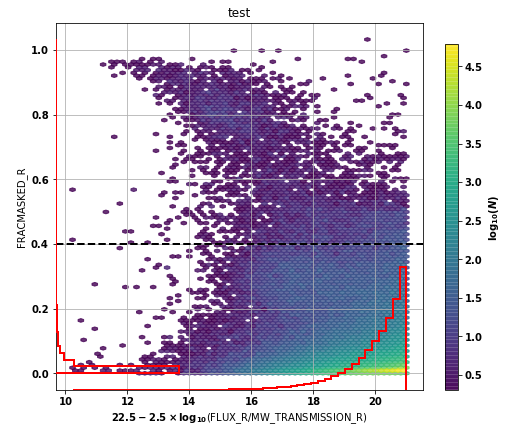

In [9]:
frac_density(cat0[bgs_all][::10], 'FRACMASKED_R', 'test', fixed=False, otherCat=False, MASK=None)

## BGS & REDMAPPER correlations

In [9]:
redmap_mem = fitsio.read('redmapper_dr8_public_v6.3_members.fits')
redmap_cat = fitsio.read('redmapper_dr8_public_v6.3_catalog.fits')

In [10]:
redmap_mem_S = cut(160, 230, -2, 18, redmap_mem)
redmap_cat_S = cut(160, 230, -2, 18, redmap_cat)

Text(0.5,1,'Sky distribution of redmapper members and cluster centres')

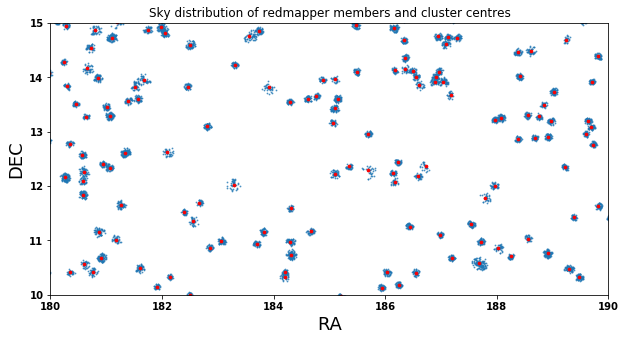

In [11]:
plt.figure(figsize=(10,5))
plt.scatter(redmap_mem_S['RA'], redmap_mem_S['DEC'], s=0.7, alpha=0.7)
plt.scatter(redmap_cat_S['RA'], redmap_cat_S['DEC'], color='red', s=7)

plt.xlim(180,190)
plt.ylim(10,15)
plt.xlabel(r'RA', size=18)
plt.ylabel(r'DEC', size=18)
plt.title(r'Sky distribution of redmapper members and cluster centres')

### Get BGS targets inside redmapper clusters

In [12]:
idx2, idx1, d2d, d_ra, d_dec = search_around(redmap_mem_S['RA'], redmap_mem_S['DEC'], cat0['RA'], 
                                             cat0['DEC'], search_radius=50)

1753014 nearby objects ~ 16.5338 %


In [13]:
primary = np.ones_like(cat0, dtype='?')

bgs_outred = primary.copy()
#BGS outside redmapper clusters. True is otside and False is inside the clusters.
bgs_outred[idx1] = False

Text(0.5,1,'Sky distribution of BGS in redmapper clusters')

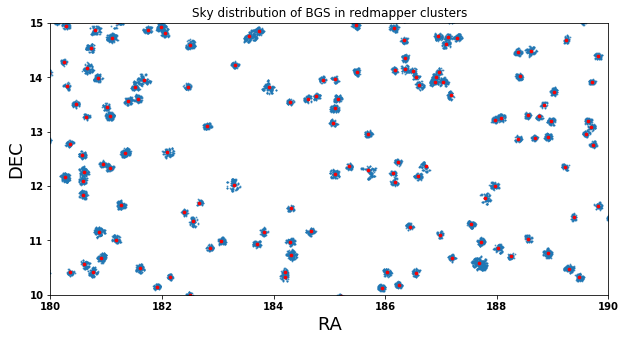

In [14]:
plt.figure(figsize=(10,5))
#plt.scatter(cat0[bgs_all]['RA'][idx1], cat0[bgs_all]['DEC'][idx1], s=0.7, alpha=0.7)
plt.scatter(cat0[(bgs_all) & (~bgs_outred)]['RA'], cat0[(bgs_all) & (~bgs_outred)]['DEC'], s=0.7, alpha=0.7)
plt.scatter(redmap_cat_S['RA'], redmap_cat_S['DEC'], color='red', s=7)

plt.xlim(180,190)
plt.ylim(10,15)
plt.xlabel(r'RA', size=18)
plt.ylabel(r'DEC', size=18)
plt.title(r'Sky distribution of BGS in redmapper clusters')

### BGS quality test with redmapper

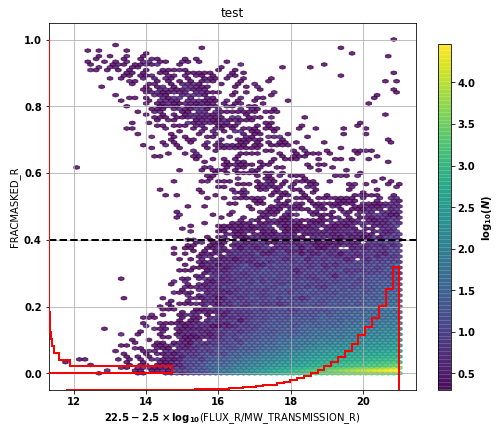

In [15]:
frac_density(cat0[(bgs_all) & (~bgs_outred)], 'FRACMASKED_R', 'test', fixed=False, otherCat=False, MASK=None)

In [64]:
def get_3sigma(DF, sigma):
    
    mean = np.mean(DF, axis=0)
    sd = np.std(DF, axis=0)
    
    MASK = np.logical_and(DF > mean - sigma * sd, DF < mean + sigma * sd)

    print('mean=%2.3g, sd=%2.3g' %(mean, sd))
    print('%2.5g %% at %2.2g-sigma level' %(len(DF[MASK])*100/len(DF), sigma))
    
    return DF[MASK], mean, sd

In [97]:
def frac_dist(colname='FRACMASKED_R', sigma=2.9, cumu=False, log=False):
    
    cattemp, mean, sd = get_3sigma(cat0[colname], sigma)
    
    Min, Max = cattemp.min(), cattemp.max()
    print('%s from %2.5g to %2.5g' %(colname, Min, Max))
        
    fig, axs = plt.subplots(figsize=(10, 8),
        nrows=2, ncols=1, sharex=True, sharey=False,
        gridspec_kw={'height_ratios':[1,1]})
        
    fracmask = cat0[colname]
    bins1 = np.linspace(Min, Max, 40)

    c1 = axs[0].hist(fracmask[bgs_all], bins=bins1, cumulative=cumu, histtype='step', align='mid', 
         color='blue', linewidth=1.5, label=r'all', log=log)

    c2 = axs[0].hist(fracmask[(bgs_all) & (~bgs_outred)], bins=bins1, cumulative=cumu, histtype='step', align='mid', 
         color='r', linewidth=1.5, label=r'In redmapper clusters', log=log)

    for i in range(2):
        axs[i].axvline(mean, linestyle='--', color='black', label=r'mean')
        axs[i].axvline(mean+1*sd, linestyle='--', color='lime', label=r'1$\sigma$')
        axs[i].axvline(mean+2*sd, linestyle='--', color='orange', label=r'2$\sigma$')
        axs[i].axvline(mean+sigma*sd, linestyle='--', color='red', label=r'%2.2g-$\sigma$' %(sigma))
        axs[i].axvline(mean-1*sd, linestyle='--', color='lime')
        axs[i].axvline(mean-2*sd, linestyle='--', color='orange')
        axs[i].axvline(mean-sigma*sd, linestyle='--', color='red')
        
        axs[i].grid()
        axs[i].set_xlim(Min-(Max-Min)*0.05, Max+(Max-Min)*0.05)

    axs[1].set_xlabel(r'%s' %(colname), size=18)
    axs[0].set_ylabel(r'N', size=18)
    
    half_bin = (c1[1][1] - c1[1][0])/2.
    axs[1].plot(c1[1][:-1]+half_bin, c2[0]/c1[0], marker='.', lw=2, color='k', label=r'overall')
    axs[1].set_ylabel(r'$f$', size=18)
    
    #============ separate between bright and faint =============
    
    rmag = flux_to_mag(cat0['FLUX_R']/cat0['MW_TRANSMISSION_R'])
    
    c1_bright = axs[0].hist(fracmask[(bgs_all) & (rmag < 19.5)], bins=bins1, cumulative=cumu, histtype='step', align='mid', 
         color='blue', linestyle='--', alpha=0.4, log=log)

    c2_bright = axs[0].hist(fracmask[(bgs_all) & (~bgs_outred) & (rmag < 19.5)], bins=bins1, cumulative=cumu, histtype='step', align='mid', 
         color='r', linestyle='--', alpha=0.4, log=log)
    
    c1_faint = axs[0].hist(fracmask[(bgs_all) & (rmag > 19.5)], bins=bins1, cumulative=cumu, histtype='step', align='mid', 
         color='blue', linestyle='-.', alpha=0.4, log=log)

    c2_faint = axs[0].hist(fracmask[(bgs_all) & (~bgs_outred) & (rmag > 19.5)], bins=bins1, cumulative=cumu, histtype='step', align='mid', 
         color='r', linestyle='-.', alpha=0.4, log=log)
    
    axs[1].plot(c1[1][:-1]+half_bin, c2_bright[0]/c1_bright[0], marker='.', lw=1, alpha=0.5, color='red', label=r'bright')
    axs[1].plot(c1[1][:-1]+half_bin, c2_faint[0]/c1_faint[0], marker='.', lw=1, alpha=0.5, color='blue', label=r'faint')

    axs[1].legend(loc='upper right')


mean=0.0523, sd=0.431
99.987 % at 2.9-sigma level
FRACMASKED_R from  0 to 1.3011


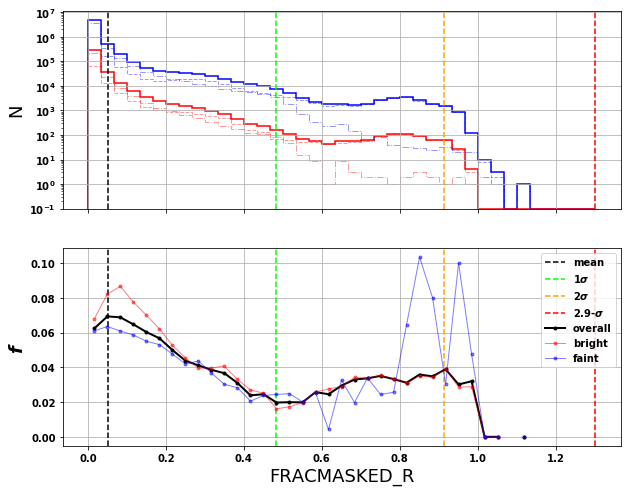

In [98]:
frac_dist('FRACMASKED_R', sigma=2.9, cumu=False, log=True)

mean=0.0523, sd=0.431
99.987 % at 2.9-sigma level
FRACMASKED_R from  0 to 1.3011


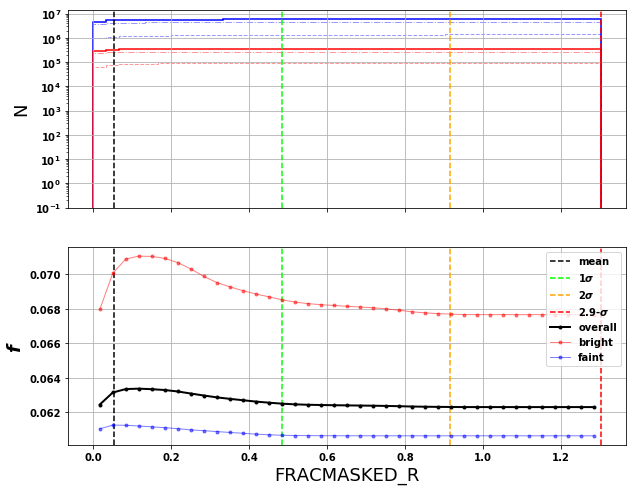

In [99]:
frac_dist('FRACMASKED_R', sigma=2.9, cumu=True, log=True)

mean=0.939, sd=0.142
99.842 % at  6-sigma level
FRACIN_R from 0.085207 to 1.1111


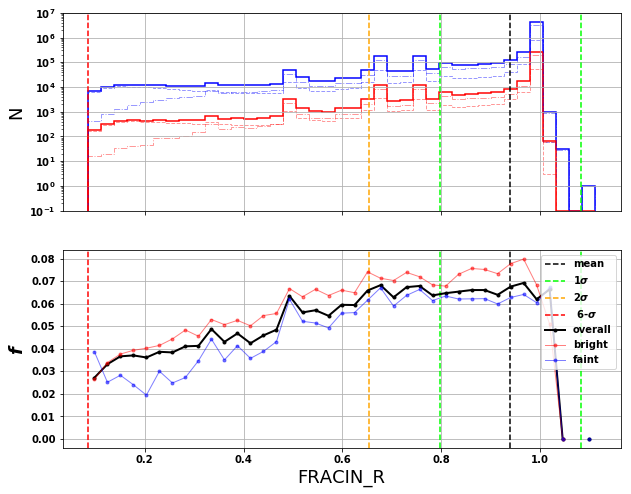

In [100]:
frac_dist('FRACIN_R', sigma=6, cumu=False, log=True)

mean=0.939, sd=0.142
99.842 % at  6-sigma level
FRACIN_R from 0.085207 to 1.1111


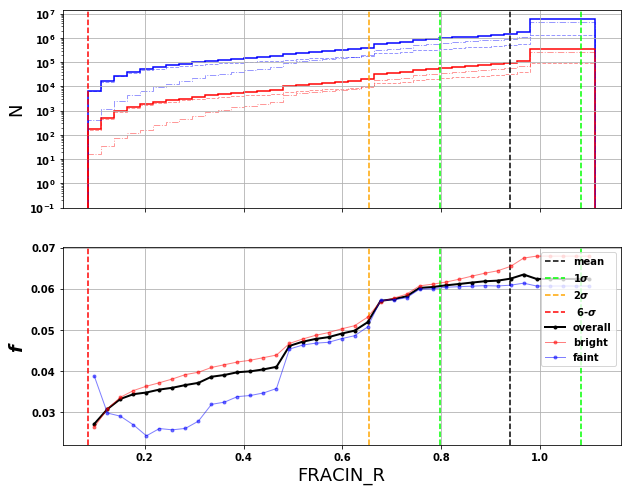

In [101]:
frac_dist('FRACIN_R', sigma=6, cumu=True, log=True)

mean=26, sd=7.61e+04
99.184 % at 0.0005-sigma level
FRACFLUX_R from -11.82 to 64.079


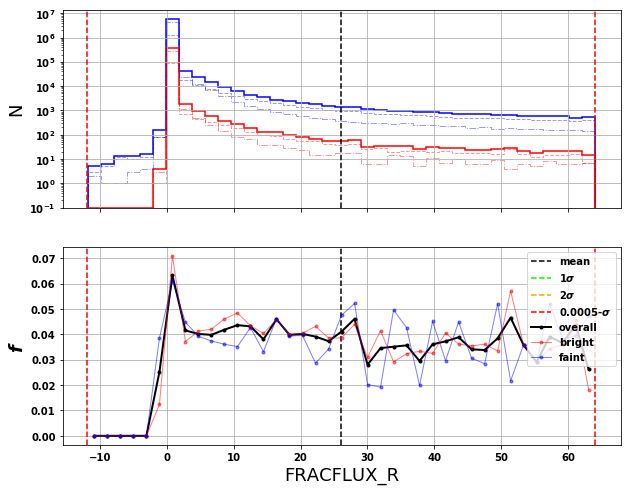

In [102]:
frac_dist('FRACFLUX_R', sigma=0.0005, cumu=False, log=True)

mean=26, sd=7.61e+04
99.184 % at 0.0005-sigma level
FRACFLUX_R from -11.82 to 64.079


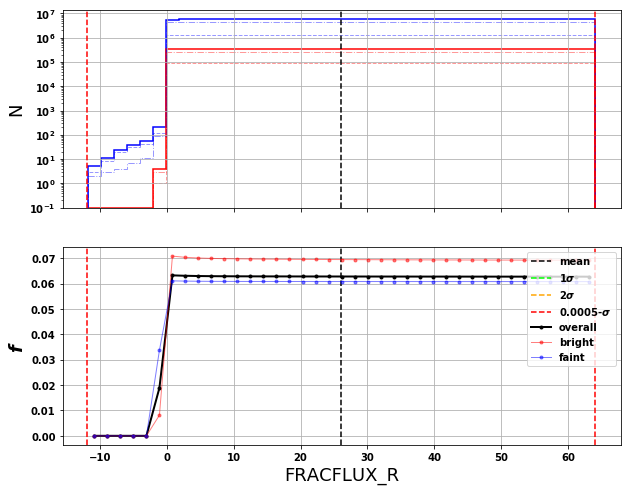

In [103]:
frac_dist('FRACFLUX_R', sigma=0.0005, cumu=True, log=True)

### postage images

In [140]:
from astropy.utils.data import download_file  #import file from URL
from matplotlib.ticker import NullFormatter

def make_cutout_table(ra_in, dec_in, other=None, othername=None, table=(2,7), compare=False,
                      scale_unit='pixscale', boxsize=30, scale=0.262, layer='decals-dr7', 
                      layer2=None, savefile=None, other_cat=None):
    """
    Produces a table comparing LEGACY survey images.
    To see the different layers see: https://github.com/yymao/decals-image-list-tool/blob/master/index.html

    Keyword arguments:
    ra_in            -- array-like: RA positions in degrees
    dec_in           -- array-like: DEC positions in degrees
    other            -- array-like: any other parameter, e.g. magnitude
    othername        -- string: name or label of the 'other' parameter
    table            -- 2D integer array: arrange of the output images in (rows * columns) form
    compare          -- boolean: True if want to get output images comparing with other layer (currently in test mode)
    scale_unit       -- striing: pixel scale default
    scale            -- float: 1:180 arcsec
    layer            -- string: type of layer from legacysurvey. e.g:
                            ls-dr67:Legacy Survey DR6+7
                            decals-dr7:DECaLS DR7
                            decals-dr7-model:DECaLS DR7 Model
                            decals-dr7-resid:DECaLS DR7 Residual
                            mzls+bass-dr6:MzLS+BASS DR6
                            mzls+bass-dr6-model:MzLS+BASS DR6 Model
                            mzls+bass-dr6-resid:MzLS+BASS DR6 Residual
    layer2            -- string: second layer to compare if 'compare=True'
    savefile          -- string: path of output image and pdf if any
    """
    de_img = []
    wi_img = []
    N = table[0]*table[1]
    size = int(round(boxsize/scale))
    print('pixels:',size)
    
    if other_cat != None:
        selects = []
        for i in range(len(ra_in)):
            
            delta = -1.
            MASK = np.ones_like(other_cat, dtype='?')
            MASK &= np.logical_and(other_cat['RA'] < ra_in[i]+(boxsize/2+delta)/3600, other_cat['RA'] > ra_in[i]-(boxsize/2+delta)/3600)
            MASK &= np.logical_and(other_cat['DEC'] < dec_in[i]+(boxsize/2+delta)/3600, other_cat['DEC'] > dec_in[i]-(boxsize/2+delta)/3600)
            for j in range(len(other_cat['RA'][MASK])):
                ra_pix = size/2 + (ra_in[i]-other_cat['RA'][MASK][j])*3600/scale
                dec_pix = size/2 + (dec_in[i]-other_cat['DEC'][MASK][j])*3600/scale
                selects.append([i, other_cat['RA'][MASK][j], other_cat['DEC'][MASK][j], ra_pix, dec_pix])
                
            
        selects = np.array(selects).transpose()
        print('A total of %i objects were found within the %i" boxsize of the %i postages' %(len(selects[0]), boxsize, len(ra_in)))


    if isinstance(ra_in, float):
        de_cutout_url = 'http://legacysurvey.org/viewer-dev/jpeg-cutout/?ra=%.12f&dec=%.12f&%s=%g&layer=%s&size=%i' % (ra_in,dec_in, scale_unit, scale, layer, size)
        img = plt.imread(download_file(de_cutout_url,cache=True,show_progress=False,timeout=120))

        fig = plt.figure(figsize=(10,10))
        
        if other != None:
            plt.text(0.1,0.9,'%s=%.1f'%(othername,other),fontsize=14,color='white')

        return

    for i in range(N):
        de_cutout_url = 'http://legacysurvey.org/viewer-dev/jpeg-cutout/?ra=%.12f&dec=%.12f&%s=%g&layer=%s&size=%g' % (ra_in[i],dec_in[i], scale_unit, scale, layer, size)
        img = plt.imread(download_file(de_cutout_url,cache=True,show_progress=False,timeout=120))
        de_img.append(img)

        if compare:
            wi_cutout_url = 'http://legacysurvey.org/viewer-dev/jpeg-cutout/?ra=%g&dec=%g&%s=%g&layer=%s&size=%g' % (ra_in[i],dec_in[i], scale_unit, scale, layer2, size)
            img = plt.imread(download_file(wi_cutout_url,cache=True,show_progress=False,timeout=120))
            wi_img.append(img)

    fig = plt.figure(figsize=(4*table[1],4*table[0]))
    
    scale_l = np.array([[size*5/8, size*7/8], [size*1/8, size*1/8]])

    for i in range(len(de_img)):
        ax = fig.add_subplot(table[0],table[1],i+1)
        ax.imshow(de_img[i], origin='lower', aspect='equal')
        ax.axvline(size/2, lw=1, color='white')
        ax.axhline(size/2, lw=1, color='white')
        ax.plot(scale_l[0], scale_l[1], lw=2, color='white')
        ax.text(size*5.7/8, size*1.3/8, '%i" ' %(boxsize/4), color='yellow')
        #ax.grid()
        ax.xaxis.set_major_formatter(NullFormatter())
        ax.yaxis.set_major_formatter(NullFormatter())
        if other_cat != None:
            mask = selects[0] == i
            ax.scatter(selects[3][mask], selects[4][mask], marker='x', color='lime')
            
        if other[i] != None:
            ax.text(0.1,0.9,'%s=%.1f'%(othername,other[i]),transform=ax.transAxes,fontsize=8,color='white')
            ax.text(0.1,0.85,'%s=%.5f'%('RA',ra_in[i]),transform=ax.transAxes,fontsize=8,color='yellow')
            ax.text(0.1,0.8,'%s=%.5f'%('DEC',dec_in[i]),transform=ax.transAxes,fontsize=8,color='yellow')

    plt.subplots_adjust(wspace=0.07, hspace=0.07)

    if compare:
        fig = plt.figure(figsize=(4*table[1],4*table[0]))
        for i in range(len(wi_img)):
            ax = fig.add_subplot(table[0],table[1],i+1)
            ax.imshow(wi_img[i])
            ax.xaxis.set_major_formatter(NullFormatter())
            ax.yaxis.set_major_formatter(NullFormatter())
            if other[i] != None:
                ax.text(0.1,0.9,'%s=%.1f'%(othername,other[i]),transform=ax.transAxes,fontsize=14,color='white')

        plt.subplots_adjust(wspace=0.07, hspace=0.07)

    if savefile != None:
        fig.savefig(savefile +'.png')
        fig.savefig(savefile +'.pdf')

In [158]:
def get_postages(CAT, N, M, get_coord=False, rand=True, other_cat=None):
    '''
    Get postage images tables with sizes NXM.
    inputs
    -------
    CAT: (array) Catalogue
    N: (integer) Number of rows
    M: (integer) Number of columns
    
    outputs
    -------
    Table of size NXM of postage images froma random sample of catalogue
    
    '''
    
    import random
    
    table = (N,M)
    boxsize = 30
    
    #rMag = CAT['MAG_VT']
    rMag = flux_to_mag(CAT['FLUX_R']/CAT['MW_TRANSMISSION_R'])
    RA, DEC = CAT['RA'], CAT['DEC']

    if rand:
        ranSelect = random.sample(range(len(RA)), N*M)
    else:
        MASK = np.ones_like(RA, dtype='?')
        N = np.linspace(0, len(RA)-1, N*M, dtype=np.int32)
        MASK[N] = False
        ranSelect = ~MASK
        
    make_cutout_table(RA[ranSelect], DEC[ranSelect], rMag[ranSelect], 'r', table, False, boxsize=boxsize, 
                  layer='decals-dr7', layer2=None, savefile=None, other_cat=other_cat)

    make_cutout_table(RA[ranSelect], DEC[ranSelect], rMag[ranSelect], 'r', table, False, boxsize=boxsize, 
                  layer='decals-dr7-model', layer2=None, savefile=None)

    if get_coord:
        return np.array([RA[ranSelect], DEC[ranSelect]])

In [160]:
rmag = flux_to_mag(cat0['FLUX_R']/cat0['MW_TRANSMISSION_R'])
bgs_fracmask = (cat0['FRACMASKED_G'] < 0.4) & (cat0['FRACMASKED_R'] < 0.4) & (cat0['FRACMASKED_Z'] < 0.4)
bgs_fracflux = (cat0['FRACFLUX_G'] < 5.0) & (cat0['FRACFLUX_R'] < 5.0) & (cat0['FRACFLUX_Z'] < 5.0)
bgs_fracin = (cat0['FRACIN_G'] > 0.3) & (cat0['FRACIN_R'] > 0.3) & (cat0['FRACIN_Z'] > 0.3)

#### FRACMASKED

This postage come with all the quality cuts applied but FRACMASKED.

pixels: 115
A total of 39 objects were found within the 30" boxsize of the 30 postages
pixels: 115


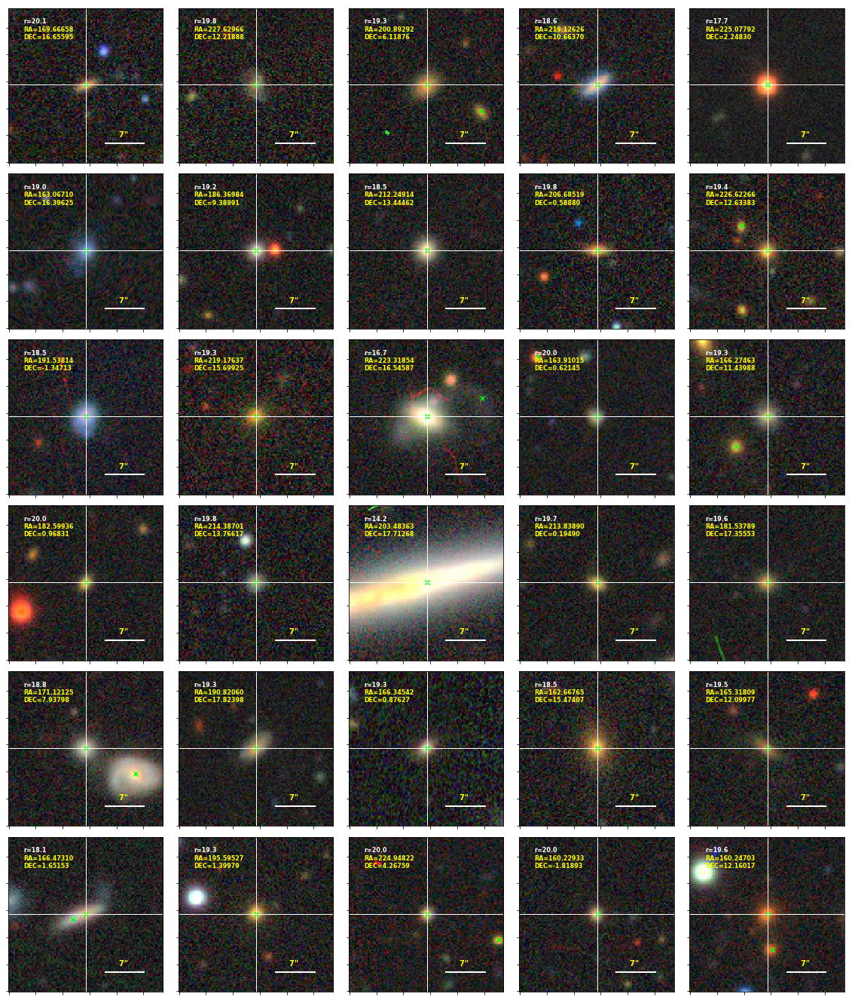

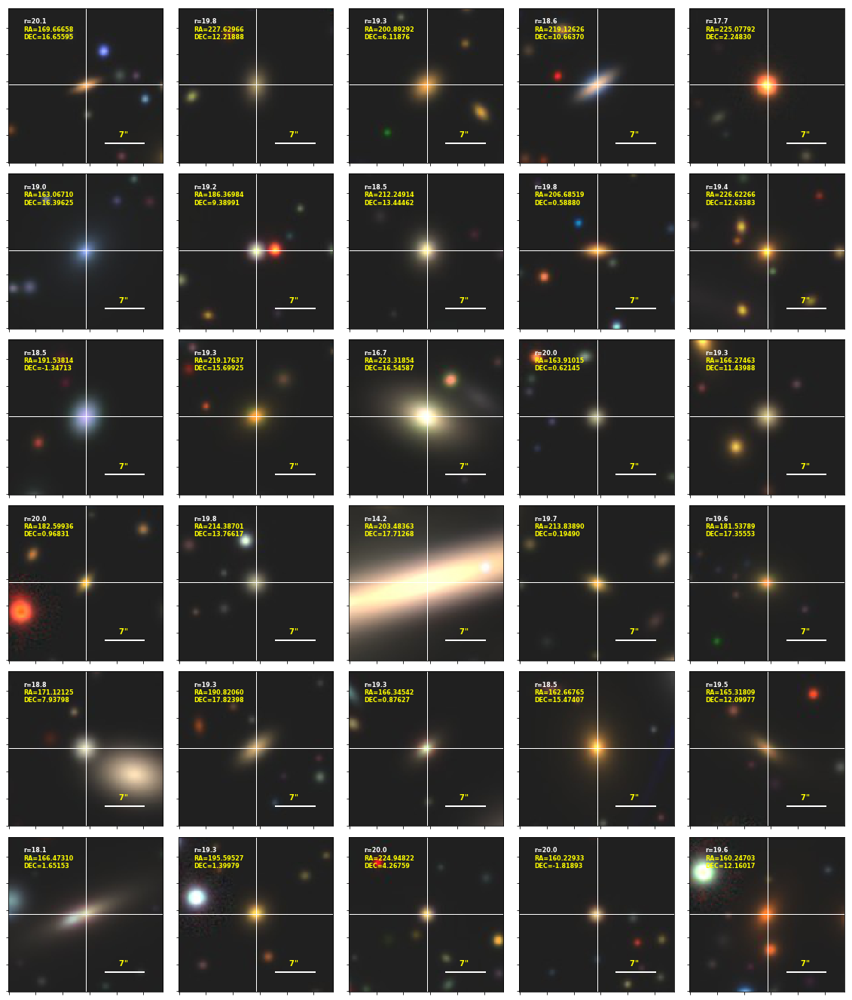

In [161]:
MASK = np.logical_and(cat0['FRACMASKED_R'] > 0, cat0['FRACMASKED_R'] < 0.4)
get_postages(cat0[(bgs_all) & (MASK) & (rmag < 20.1) & (bgs_fracflux) & (bgs_fracin)], 6,5, 
             other_cat=cat0[bgs_aqc])

pixels: 115
A total of 26 objects were found within the 30" boxsize of the 30 postages
pixels: 115


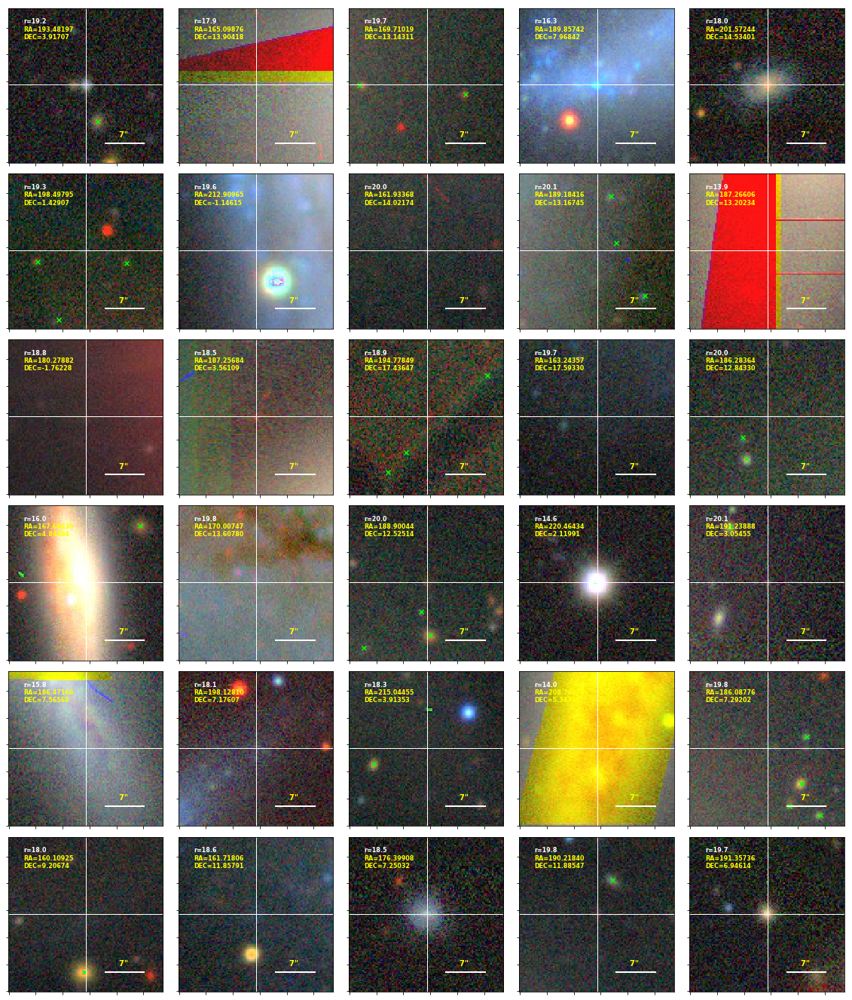

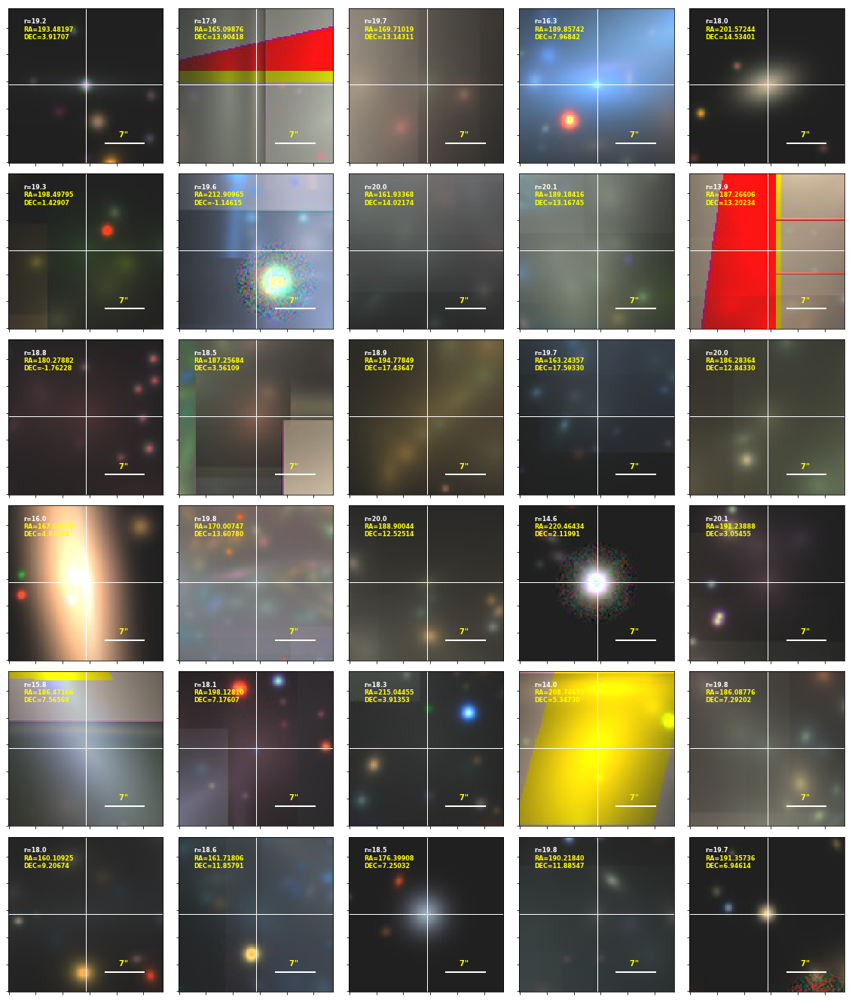

In [162]:
MASK2 = np.logical_and(cat0['FRACMASKED_R'] > 0.4, cat0['FRACMASKED_R'] < 0.6)
get_postages(cat0[(bgs_all) & (MASK2) & (rmag < 20.1) & (bgs_fracflux) & (bgs_fracin)], 6,5, other_cat=cat0[bgs_aqc])

pixels: 115
A total of 5 objects were found within the 30" boxsize of the 30 postages
pixels: 115


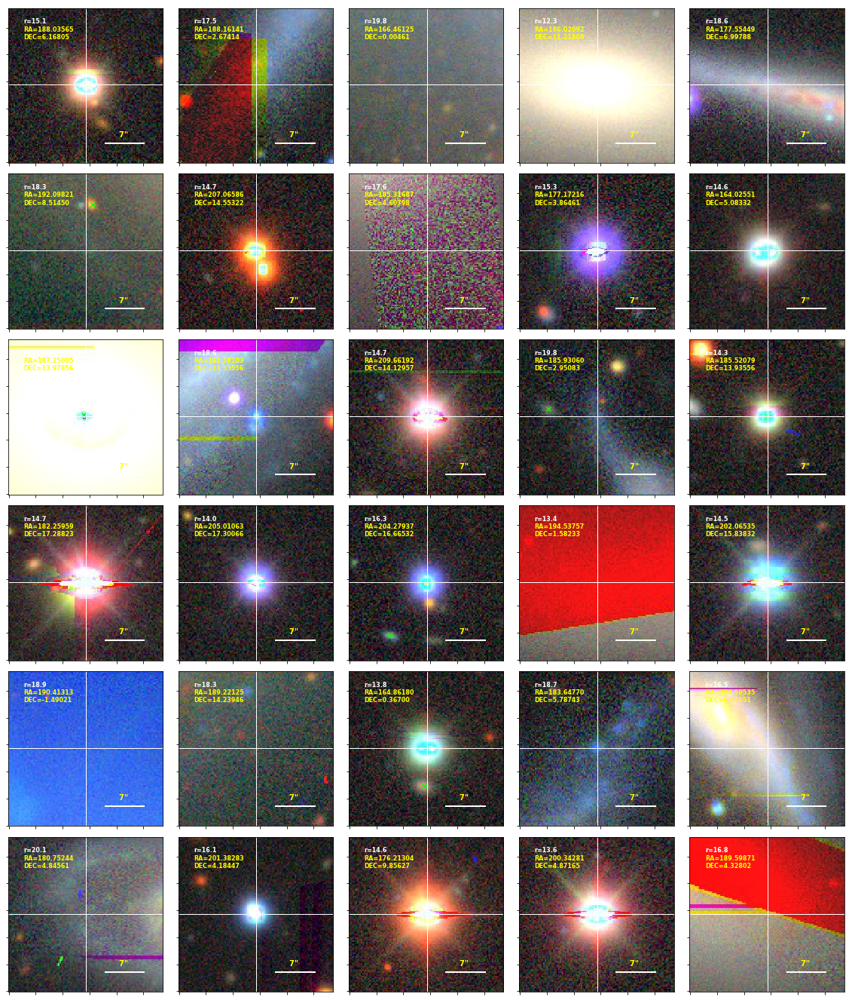

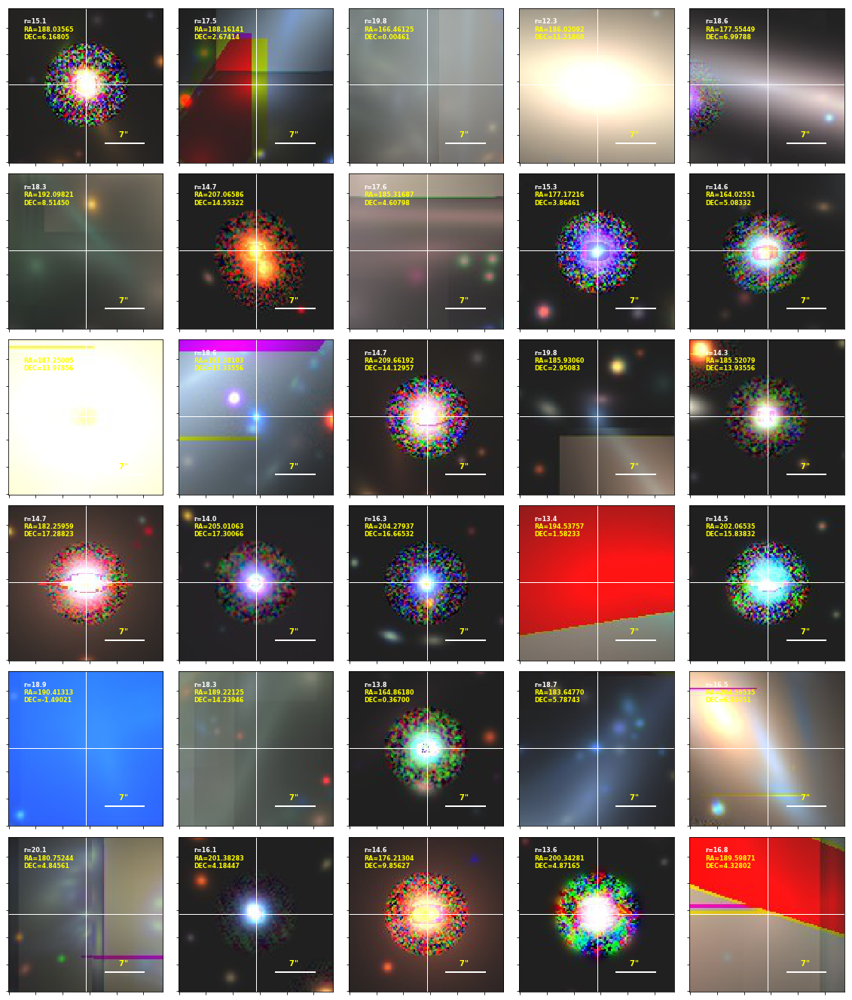

In [163]:
MASK3 = np.logical_and(cat0['FRACMASKED_R'] > 0.6, cat0['FRACMASKED_R'] < 0.8)
get_postages(cat0[(bgs_all) & (MASK3) & (rmag < 20.1) & (bgs_fracflux) & (bgs_fracin)], 6,5, other_cat=cat0[bgs_aqc])

#### FRACIN

This postages come with all the quality cuts applied but FRACIN.

pixels: 115
A total of 25 objects were found within the 30" boxsize of the 30 postages
pixels: 115


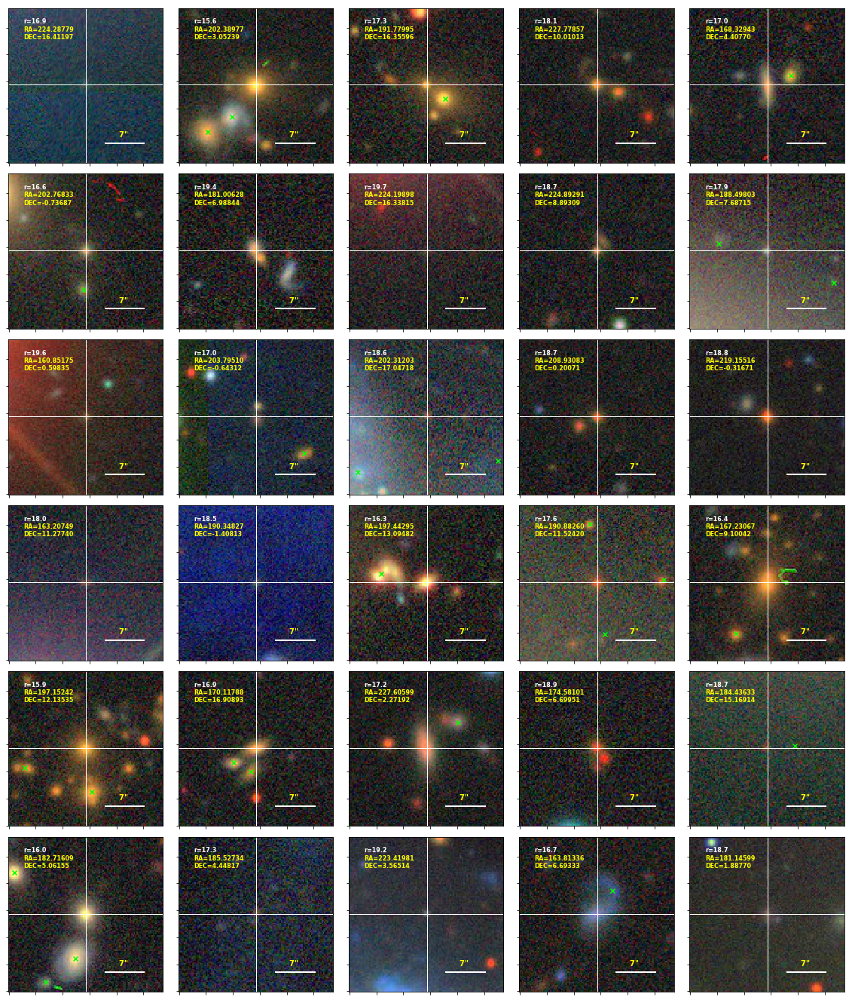

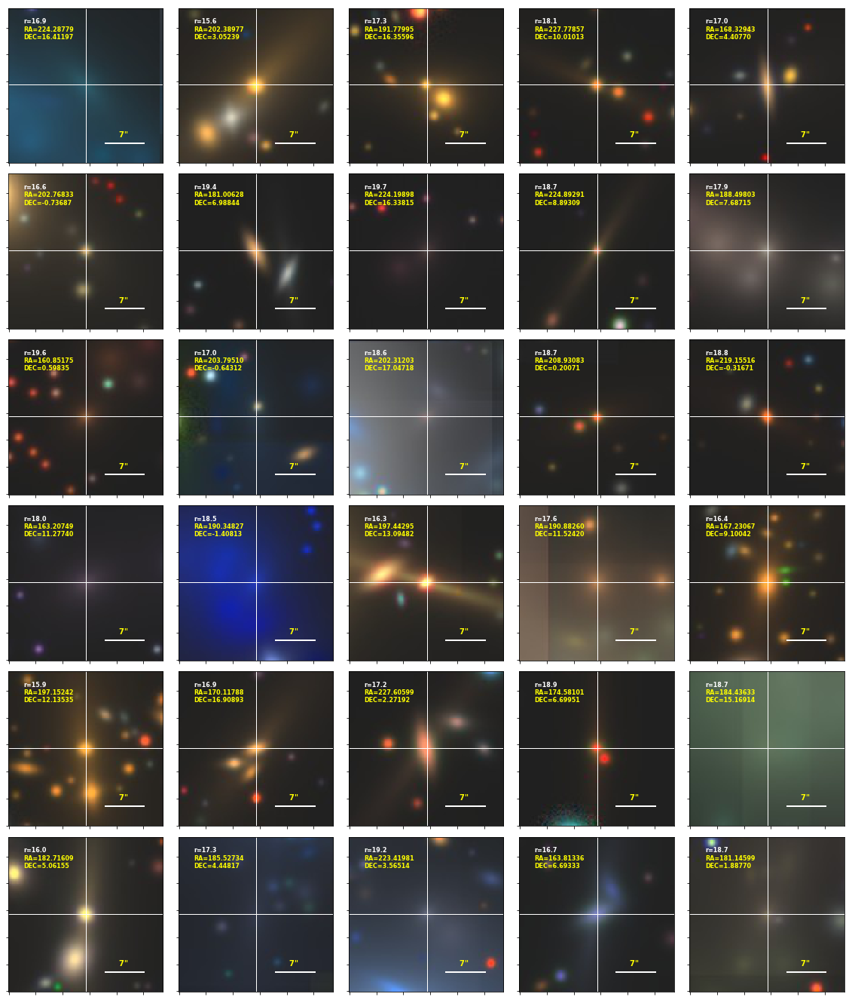

In [164]:
MASKfracin = np.logical_and(cat0['FRACIN_R'] > 0, cat0['FRACIN_R'] < 0.3)
get_postages(cat0[(bgs_all) & (MASKfracin) & (rmag < 20.1) & (bgs_fracflux) & (bgs_fracmask)], 6,5, 
             other_cat=cat0[bgs_aqc])

pixels: 115
A total of 49 objects were found within the 30" boxsize of the 30 postages
pixels: 115


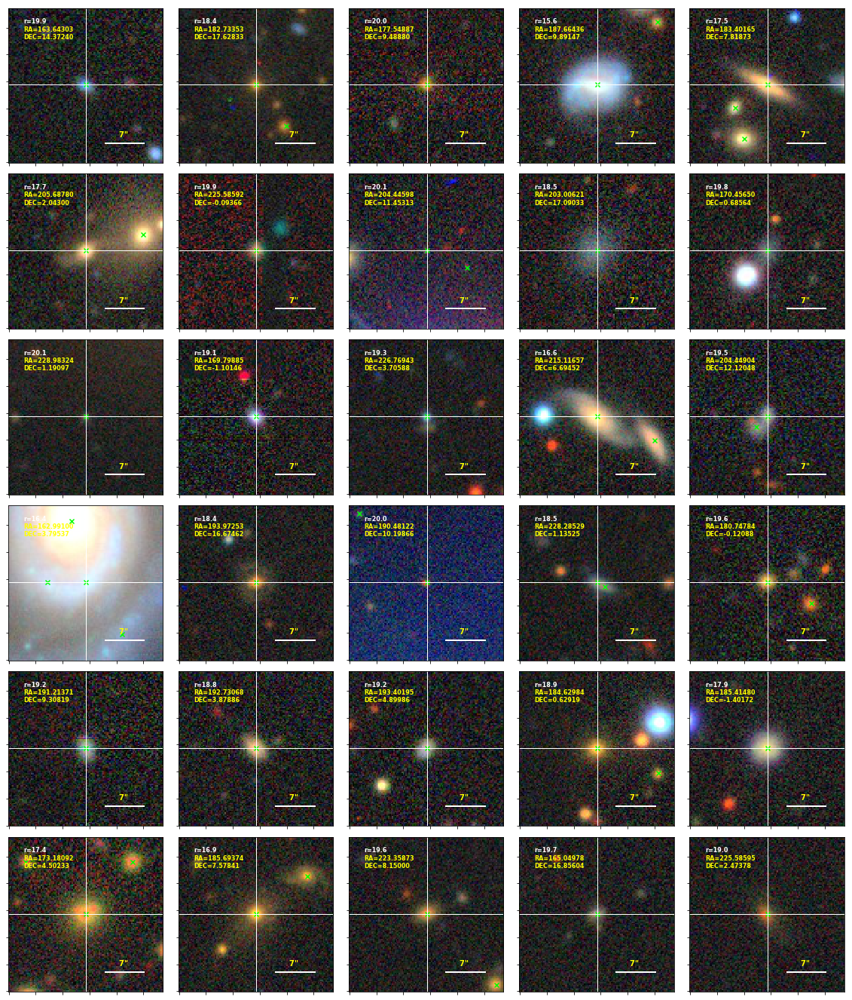

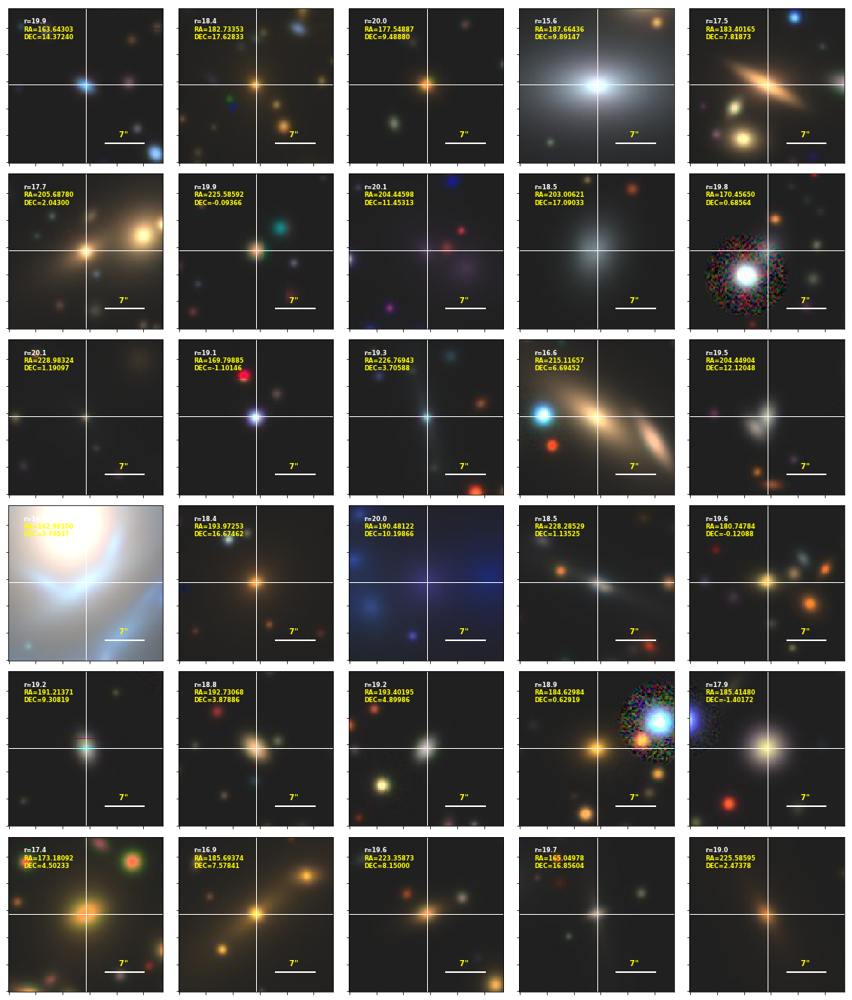

In [165]:
MASKfracin2 = np.logical_and(cat0['FRACIN_R'] > 0.3, cat0['FRACIN_R'] < 0.6)
get_postages(cat0[(bgs_all) & (MASKfracin2) & (rmag < 20.1) & (bgs_fracflux) & (bgs_fracmask)], 6,5, 
             other_cat=cat0[bgs_aqc])

pixels: 115
A total of 33 objects were found within the 30" boxsize of the 30 postages
pixels: 115


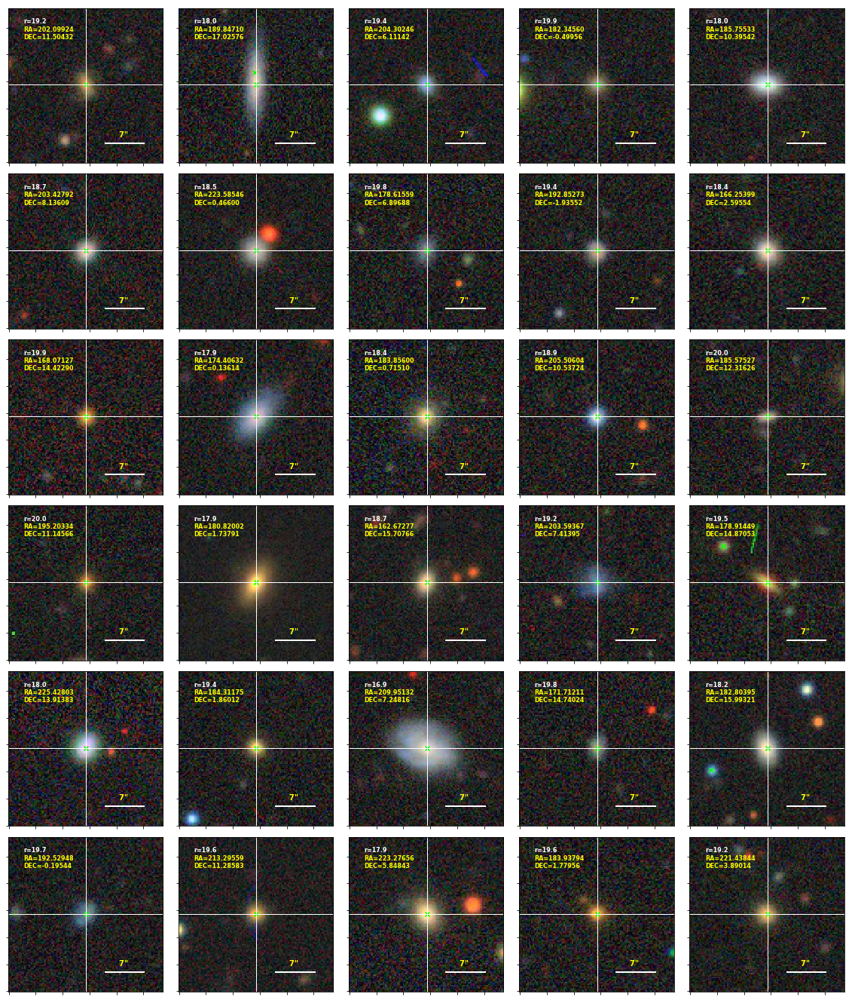

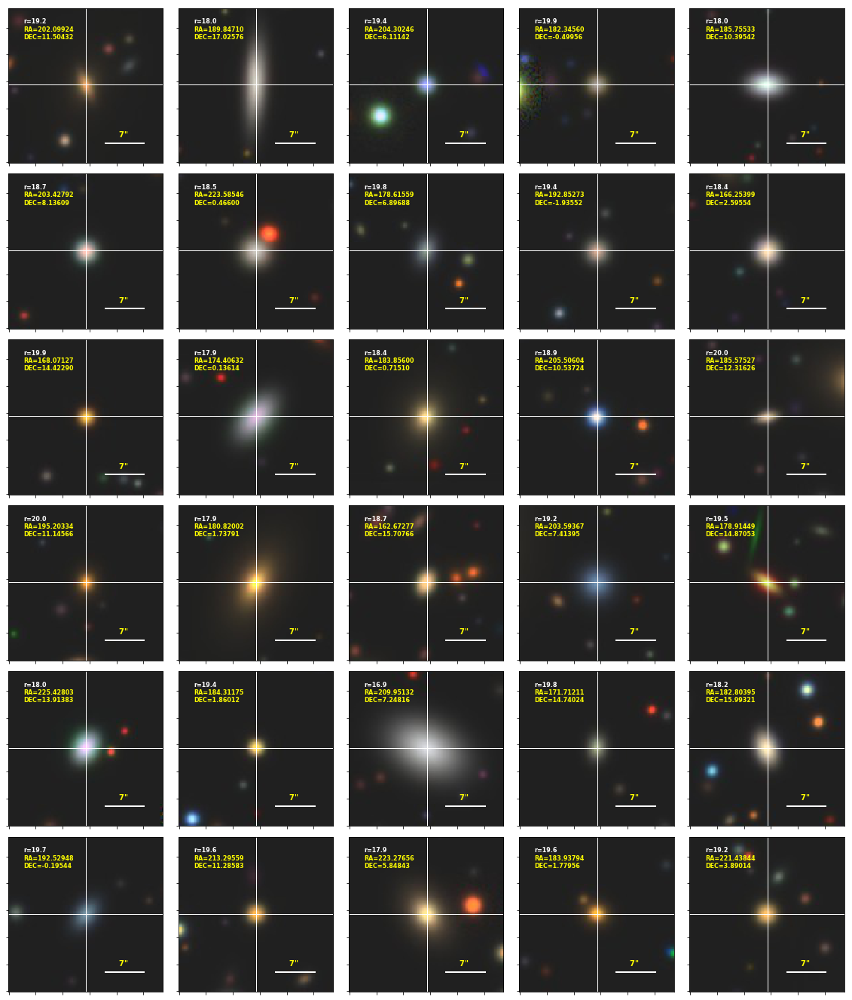

In [166]:
MASKfracin3 = np.logical_and(cat0['FRACIN_R'] > 0.6, cat0['FRACIN_R'] < 1)
get_postages(cat0[(bgs_all) & (MASKfracin3) & (rmag < 20.1) & (bgs_fracflux) & (bgs_fracmask)], 6,5, 
             other_cat=cat0[bgs_aqc])

#### FRACFLUX

This postages come with all the quality cuts applied but FRACFLUX.

pixels: 115
A total of 52 objects were found within the 30" boxsize of the 30 postages
pixels: 115


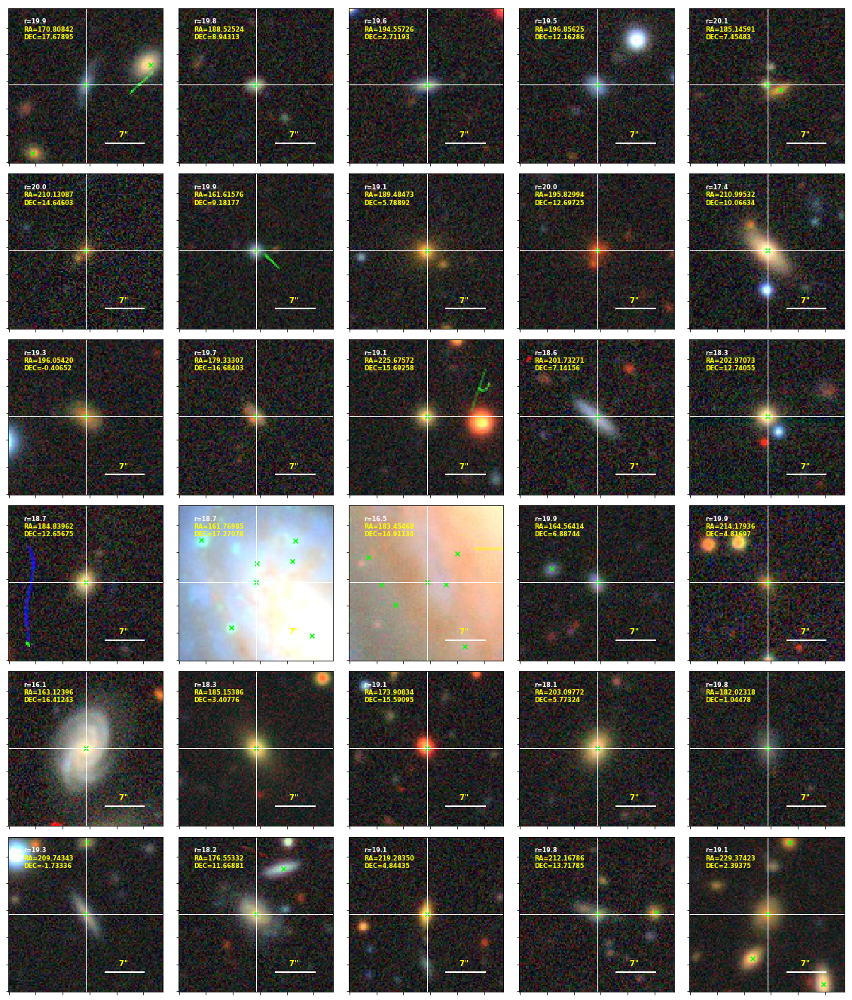

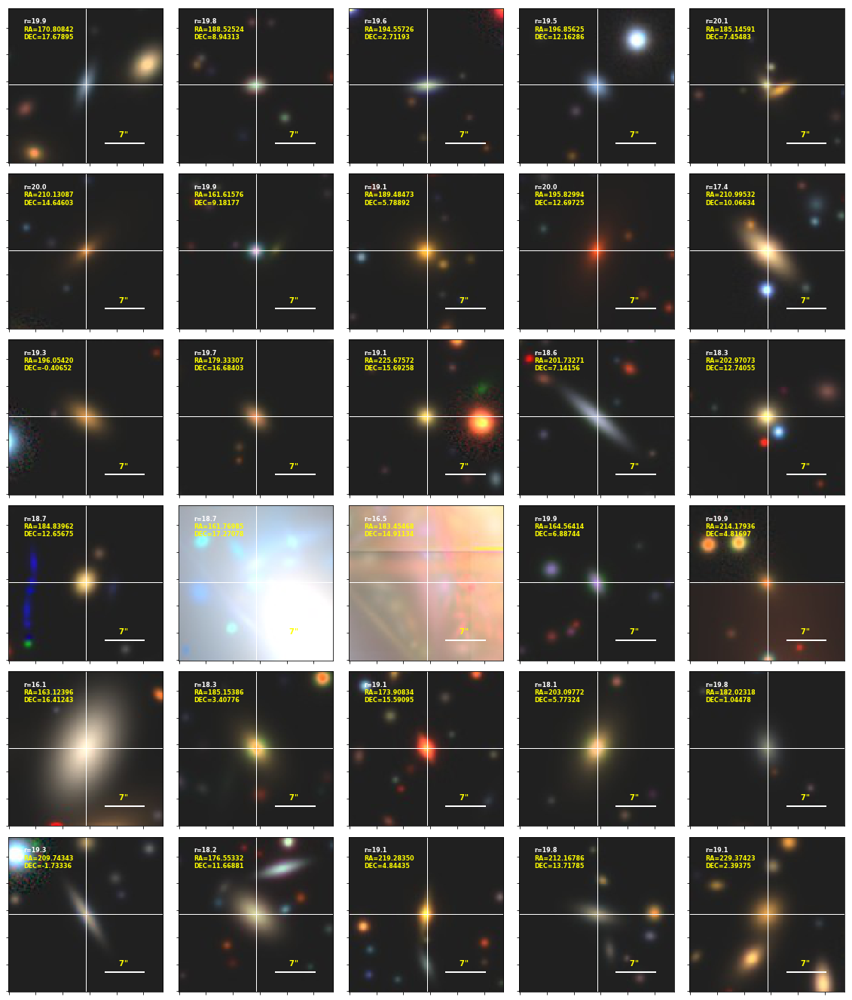

In [167]:
MASKfracflux = np.logical_and(cat0['FRACFLUX_R'] > 0, cat0['FRACFLUX_R'] < 5)
get_postages(cat0[(bgs_all) & (MASKfracflux) & (rmag < 20.1) & (bgs_fracin) & (bgs_fracmask)], 6,5, 
             other_cat=cat0[bgs_aqc])

pixels: 115
A total of 62 objects were found within the 30" boxsize of the 30 postages
pixels: 115


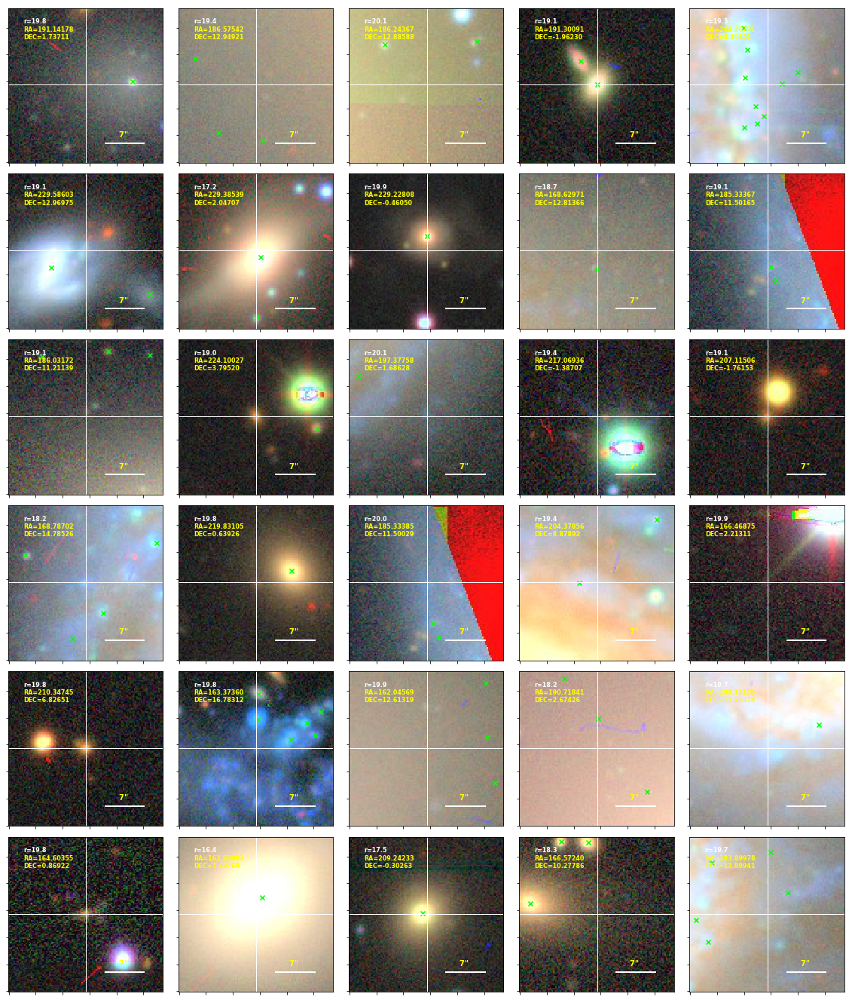

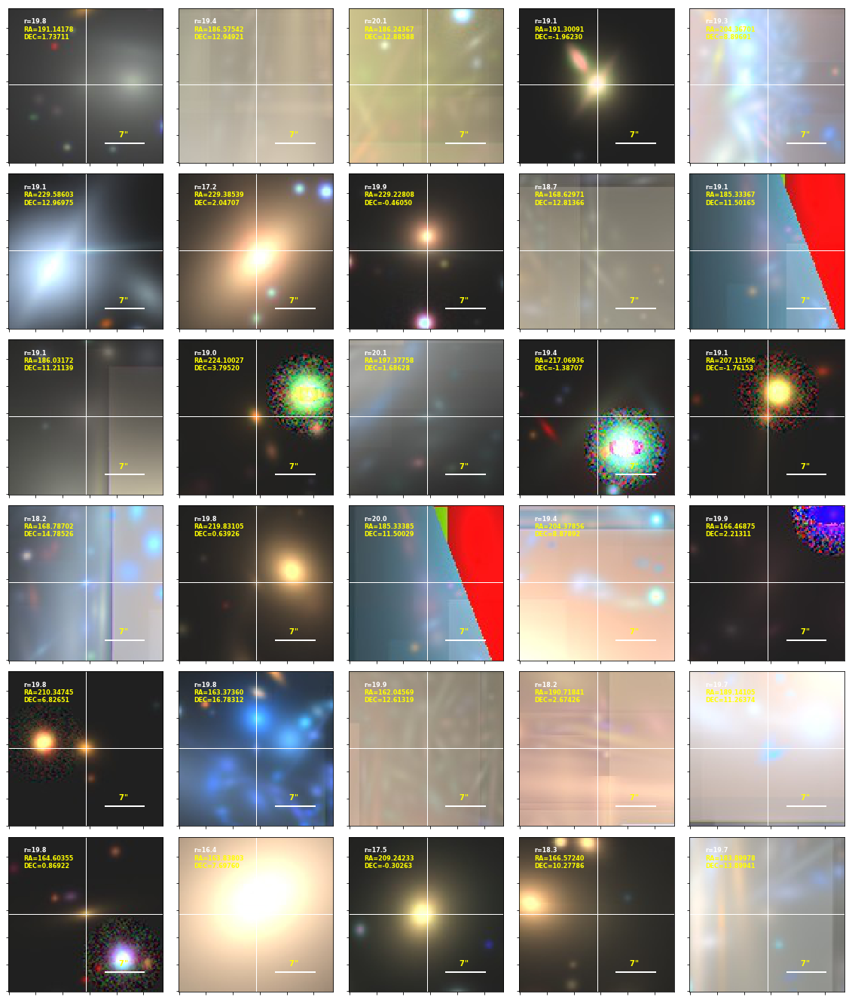

In [168]:
MASKfracflux2 = np.logical_and(cat0['FRACFLUX_R'] > 5, cat0['FRACFLUX_R'] < 10)
get_postages(cat0[(bgs_all) & (MASKfracflux2) & (rmag < 20.1) & (bgs_fracin) & (bgs_fracmask)], 6,5, 
             other_cat=cat0[bgs_aqc])

### 2D-stacks BGS & redmapper

In [117]:
def circular_mask_radii_func(MAG, radii_1):
    '''
    Define mask radius as a function of the magnitude

    Inputs
    ------
    magnitude: Magnitude in (array);

    Output
    ------
    radii: mask radii (array)
    '''
    from scipy.interpolate import interp1d
    
    x, y = np.transpose(radii_1)
    circular_mask_radii_func = interp1d(x, y, bounds_error=False, fill_value=(y[0], y[-1]))

    # mask radius in arcsec
    return circular_mask_radii_func(MAG)

In [113]:
#Rongpu's circ radii
rongpuLRG_radii = [[4.0, 210.],[4.5, 210.], [5.5, 200.], [6.25, 150.], [6.75, 125.],
                   [7.25, 120.], [7.75, 110.], [8.25, 100.], [8.75,  75.], [9.25,  60.],
                   [9.75,  55.], [ 10.25,  50.], [ 10.75,  48.], [ 11.25,  40.], [ 11.75,  37.], 
                   [ 12.25,  25.], [ 12.75,  20.], [ 13.25,  18.], [ 13.75,  16.], [ 14.25,  12.], 
                   [ 14.75,  11.], [ 15.25,  11.], [ 15.75,  10.]]

#Rongpu's length radii (diff spikes)
rongpuLRG_length_radii = [[4.0, 600.], [4.5, 600.], [5.5, 600.], [6.25, 540.], [6.75, 520.], [7.25, 500.], 
                   [7.75, 320.], [8.25, 300.], [8.75, 290.], [9.25, 160.], [9.75, 150.], [ 10.25, 140.],
                   [ 10.75, 130.], [ 11.25, 130.], [ 11.75, 100.], [ 12.25, 60.], [ 12.75, 40.], [ 13., 40.]]

#Rongpu's widht radii (diff spikes)
rongpuLRG_widht_radii = [[8., 25.], [13., 16.]]

#kyle_radii's = rongpuLRG_radii's/np.sqrt(2)
kyle_radii = []
for i in range(len(rongpuLRG_radii)):
    kyle_radii.append([rongpuLRG_radii[i][0], rongpuLRG_radii[i][1]/np.sqrt(2)])

kyle_length_radii = []
for i in range(len(rongpuLRG_length_radii)):
    kyle_length_radii.append([rongpuLRG_length_radii[i][0], rongpuLRG_length_radii[i][1]/np.sqrt(2)])

kyle_widht_radii = []
for i in range(len(rongpuLRG_widht_radii)):
    kyle_widht_radii.append([rongpuLRG_widht_radii[i][0], rongpuLRG_widht_radii[i][1]/np.sqrt(2)])
    
#TWOMASS radii
twomass_radii = [[9.5,100], [10.5, 80], [11.5, 70], [12.5, 50], [13.5, 30], 
                 [14.5, 20], [15.5, 10], [16.5, 5]]

#LSLGA radii
LSLGA_radii = [[9.5,100], [10.5, 90], [11.5, 80], [12.5, 70], [13.5, 60], 
               [14.5, 50], [15.5, 35], [16.5, 25], [17.5, 15], [17.5, 10], [18, 8]]

In [104]:
def relative_density_plot(d_ra, d_dec, d2d, search_radius, ref_density, nbins=101, return_res=False, show=True):

    bins = np.linspace(-search_radius, search_radius, nbins)
    bin_spacing = bins[1] - bins[0]
    bincenter = (bins[1:]+bins[:-1])/2
    mesh_ra, mesh_dec = np.meshgrid(bincenter, bincenter)
    mesh_d2d = np.sqrt(mesh_ra**2 + mesh_dec**2)
    mask = (d2d>2.)
    #taking the 2d histogram and divide by the area of each bin to get the density
    density, _, _ = np.histogram2d(d_ra[mask], d_dec[mask], bins=bins)/(bin_spacing**2)
    #ignoring data outside the circle with radius='search radius'
    mask = mesh_d2d >= bins.max()-bin_spacing
    density[mask] = np.nan
    density_ratio = density/ref_density
    den_rat = density_ratio[~np.isnan(density_ratio)]
    denmin = den_rat.min()
    denmax = den_rat.max()
    print('Minimum density ratio = %g, Maximum density ratio = %g' %(denmin, denmax))
    plt.figure(figsize=(8, 8))
    plt.imshow(density_ratio.transpose()-1, origin='lower', aspect='equal',
               cmap='seismic', extent=bins.max()*np.array([-1, 1, -1, 1]), 
               vmin=-3, vmax=3)
    plt.colorbar(fraction=0.046, pad=0.04)
    if show:
        plt.show()

    if return_res:
        return bins, mesh_d2d, density_ratio

In [114]:
def overdensity(cat, star, radii_1, nameMag, slitw, density=False, magbins=(8,14,4), radii_2=None):
    '''
    Get scatter and density plots of objects of cat1 around objects of cat2 within a search radius in arcsec.

    Inputs
    ------
    cat: (array) catalogue 1;
    star: (array) catalogue 2;
    nameMag: (string) label of magnitude in catalogue 2;
    slitw: (float, integer) slit widht;
    density: (boolean) True to get the density as function of distance (arcsec) within shells;
    magbins: (integers) format to separate the magnitude bins in cat2 (min, max, number bins);

    Output
    ------
    (distance (arcsec), density) if density=True
    '''
    # define the slit width for estimating the overdensity off diffraction spikes
    slit_width = slitw
    search_radius = 240.

    # Paramater for estimating the overdensities
    annulus_min = 1
    annulus_max = 240.

    ra2 = star['RA']
    dec2 = star['DEC']
    ra1 = cat['RA']
    dec1 = cat['DEC']

    if density:

        idx2, idx1, d2d, d_ra, d_dec = search_around(ra2, dec2, ra1, dec1,
                                                 search_radius=search_radius)
        density = []
        shells = np.linspace(1, search_radius, search_radius)
        for i in range(len(shells)-1):

            ntot_annulus = np.sum((d2d>shells[i]) & (d2d<shells[i+1]))
            density_annulus = ntot_annulus/(np.pi*(shells[i+1]**2 - shells[i]**2))
            bincenter = (shells[i]+shells[i+1])/2

            density.append([bincenter, density_annulus])

        density = np.array(density).transpose()
        plt.figure(figsize=(12, 8))
        plt.semilogy(density[0], density[1])
        plt.xlabel(r'r(arcsec)')
        plt.ylabel(r'N/($\pi r^2$)')
        plt.grid()
        plt.show()

        return density


    mag_bins = np.linspace(magbins[0], magbins[1], magbins[2])

    for index in range(len(mag_bins)):

        if index==0:
            mask_star = (star[nameMag]<mag_bins[index])
            title = '{} < {:.2f}'.format(nameMag,mag_bins[0], np.sum(mask_star))
        else:
            mask_star = (star[nameMag]>mag_bins[index-1]) & (star[nameMag]<mag_bins[index])
            title = '{:.2f} < {} < {:.2f}'.format(mag_bins[index-1], nameMag, mag_bins[index], np.sum(mask_star))

        print(title)

        #get the mask radii from the mean magnitude
        mag_mean = np.mean(star[nameMag][mask_star])
        print('mag_mean', mag_mean)
        mask_radius = circular_mask_radii_func([mag_mean], radii_1)[0]
        if radii_2:
            mask_radius2 = circular_mask_radii_func([mag_mean], radii_2)[0]

        idx2, idx1, d2d, d_ra, d_dec = search_around(ra2[mask_star], dec2[mask_star], ra1, dec1,
                                                 search_radius=search_radius)

        print('%d sources ~%g %% ' %(len(ra2[mask_star]),100*len(ra2[mask_star])/len(ra2)))

        markersize = np.max([0.01, np.min([10, 0.3*100000/len(idx2)])])
        axis = [-search_radius*1.05, search_radius*1.05, -search_radius*1.05, search_radius*1.05]
        #axScatter = scatter_plot(d_ra, d_dec, markersize=markersize, alpha=0.4, figsize=6.5, axis=axis, title=title)

        ntot_annulus = np.sum((d2d>annulus_min) & (d2d<annulus_max))
        density_annulus = ntot_annulus/(np.pi*(annulus_max**2 - annulus_min**2))

        bins, mesh_d2d, density_ratio = relative_density_plot(d_ra, d_dec, d2d, search_radius,
                                                              ref_density=density_annulus, return_res=True,
                                                              show=False, nbins=101)

        #plt.axvline(slit_width)
        #plt.axvline(-slit_width)
        #plt.axhline(slit_width)
        #plt.axhline(-slit_width)    
        angle_array = np.linspace(0, 2*np.pi, 240)
        x = mask_radius * np.sin(angle_array)
        y = mask_radius* np.cos(angle_array)
        plt.plot(x, y, 'k', lw=1.5)
        if radii_2:
            x2 = mask_radius2 * np.sin(angle_array)
            y2 = mask_radius2 * np.cos(angle_array)
            plt.plot(x2, y2, 'k', lw=1.5, linestyle='--')
        
        plt.title(title)
        plt.show()

Z_SPEC < 0.50
mag_mean 0.03126
298321 nearby objects ~ 5.27981 %
3194 sources ~94.525 % 
Minimum density ratio = 0.372445, Maximum density ratio = 5.42705


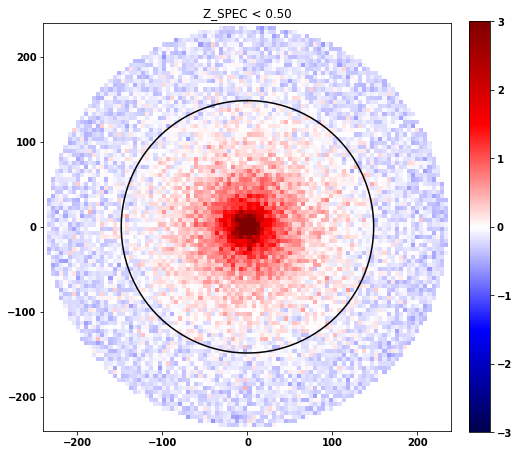

0.50 < Z_SPEC < 0.60
mag_mean 0.534478
13566 nearby objects ~ 0.240097 %
184 sources ~5.4454 % 
Minimum density ratio = 0, Maximum density ratio = 6.45393


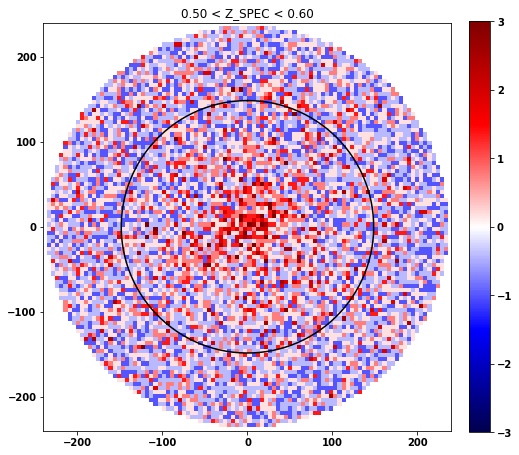

Z_SPEC < 0.50
mag_mean 0.03126
4272 nearby objects ~ 3.18644 %
3194 sources ~94.525 % 
Minimum density ratio = 0, Maximum density ratio = 16.7143


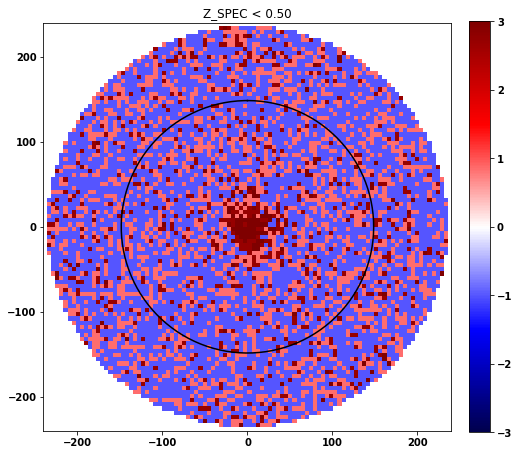

0.50 < Z_SPEC < 0.60
mag_mean 0.534478
232 nearby objects ~ 0.173047 %
184 sources ~5.4454 % 
Minimum density ratio = 0, Maximum density ratio = 67.9987


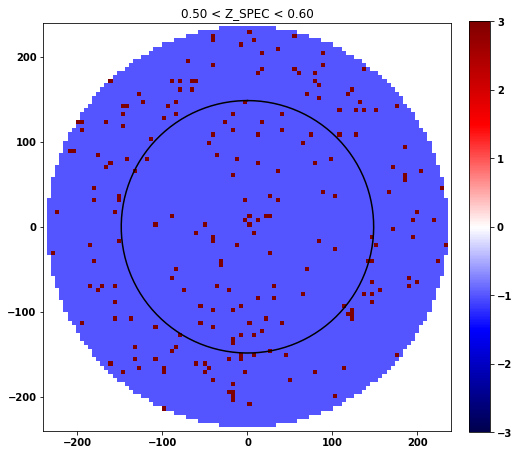

Z_SPEC < 0.50
mag_mean 0.03126
473 nearby objects ~ 2.41635 %
3194 sources ~94.525 % 
Minimum density ratio = 0, Maximum density ratio = 49.813


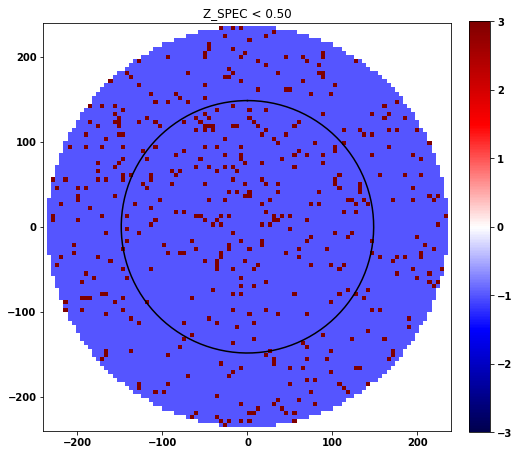

0.50 < Z_SPEC < 0.60
mag_mean 0.534478
28 nearby objects ~ 0.14304 %
184 sources ~5.4454 % 
Minimum density ratio = 0, Maximum density ratio = 841.483


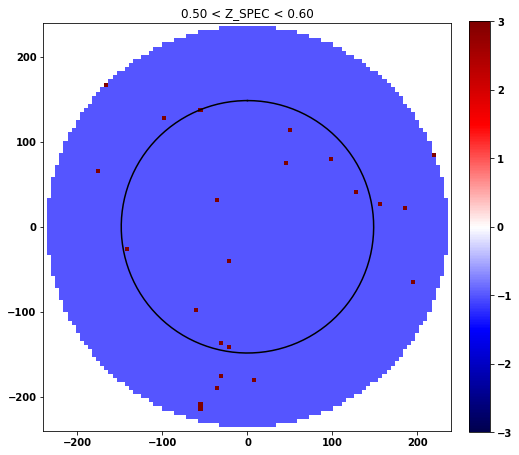

Z_SPEC < 0.50
mag_mean 0.03126
471 nearby objects ~ 3.10563 %
3194 sources ~94.525 % 
Minimum density ratio = 0, Maximum density ratio = 50.0245


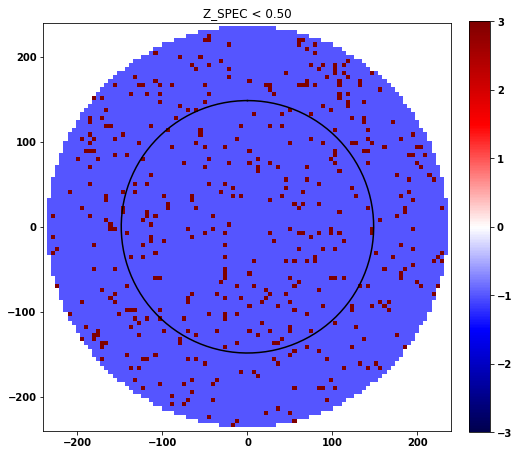

0.50 < Z_SPEC < 0.60
mag_mean 0.534478
24 nearby objects ~ 0.158249 %
184 sources ~5.4454 % 
Minimum density ratio = 0, Maximum density ratio = 327.244


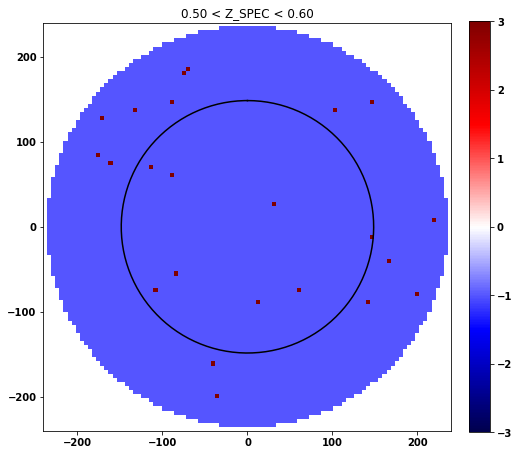

In [121]:
fracbins = np.linspace(0, 1, 5)
for i in range(len(fracbins)-1):
    
    MASK = np.logical_and(cat0['FRACMASKED_R'] > fracbins[i], cat0['FRACMASKED_R'] < fracbins[i+1])
    overdensity(cat0[(bgs_all) & (MASK)], redmap_cat_S, kyle_radii, 'Z_SPEC', 35, density=False, magbins=(0.5,0.6,2))

## K-Means

In [15]:
import scipy as sp
import time
import imageio
from sklearn import cluster, datasets
from sklearn.cluster  import KMeans
from sklearn.datasets import load_digits            
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import pandas as pd

from scipy.cluster.vq import kmeans

In [12]:
df = cut(160, 180, 5,10, cat0[bgs_all])

In [174]:
cols = ('FLUX_G', 'FLUX_R','FLUX_Z', 'FLUX_W1', 'FLUX_W2', 
        'FRACMASKED_G', 'FRACMASKED_R', 'FRACMASKED_Z', 'PSFSIZE_U', 'PSFSIZE_G',
        'PSFSIZE_R', 'PSFSIZE_I', 'PSFSIZE_Z', 'PSFSIZE_Y', 'PSFDEPTH_U', 'PSFDEPTH_G',
        'PSFDEPTH_R', 'PSFDEPTH_I', 'PSFDEPTH_Z', 'PSFDEPTH_Y', 'MW_TRANSMISSION_G', 
        'MW_TRANSMISSION_R', 'MW_TRANSMISSION_Z')
df2 = pd.DataFrame(df, columns=cols)
#df2 = Table(df, names=cols)

In [175]:
X = np.matrix((df2))

In [176]:
X.shape

(411599, 23)

In [177]:
N = 10
Kmeans = KMeans(n_clusters = N, init='k-means++')
Kmeans.fit(X)
indices = Kmeans.predict(X)

for i in range(0,N+1):
    
    print(i, np.sum(indices == i))
    
df2['indices'] = indices

0 135546
1 1
2 1
3 81267
4 6
5 3
6 411
7 37
8 194323
9 4
10 0


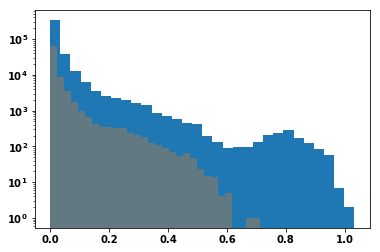

In [193]:
plt.hist(df2['FRACMASKED_R'], bins=30, log=True, alpha=1)
plt.hist(df2['FRACMASKED_R'][df2['indices'] == 3], bins=30, log=True, alpha=0.3)
plt.show()

In [198]:
centroids=[[] for i in range(1,10)]
euclidean_distances=[0 for i in range(len(X))]
cluster_averaged_distances=[0 for i in range(1,10)]

for K in range(1,10):
    clf = KMeans(n_clusters = K, init='k-means++')
    clf.fit(X.astype(float))
    
    indices= clf.predict(X)    
    centroids= clf.cluster_centers_ 
    
    for j in range(len(X)):
        euclidean_distances[j]=0
        cluster=indices[j]
        for k in range(22):
            euclidean_distances[j]+=(X[j][k] - centroids[cluster][k])**2
        euclidean_distances[j]=(euclidean_distances[j])**0.5

    cluster_averaged_distances[K-1]=np.mean(euclidean_distances)
               
plt.plot(range(1,10),cluster_averaged_distances)
plt.grid(True)
plt.xlabel('Number of clusters')
plt.ylabel('Average within-cluster sum of squares')
tt = plt.title('Example Elbow Curve')  

ValueError: input must be a square array

# dfA = Table(df)

In [181]:
dfA['indices'] = indices

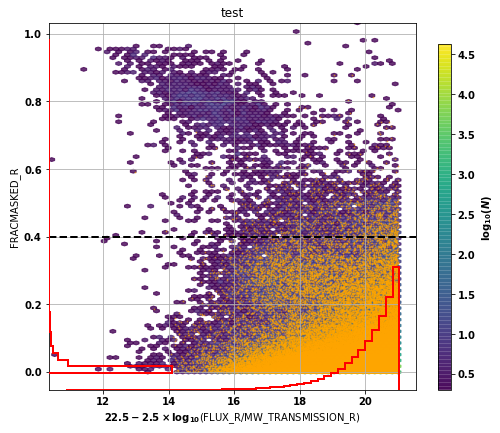

In [195]:
mask = (dfA['indices'] == 3) | (dfA['indices'] == 8)
frac_density(dfA, 'FRACMASKED_R', 'test', fixed=False, otherCat=True, MASK=mask)

# DEV ZONE

## Relaxing Quality Cuts test

In [488]:
def fiberflux_lite(cat1, col1, col2, A, title, N, fixed=False, shadow=False):
    
    mag1 = cat1[col1]
    mag2 = flux_to_mag(cat1[col2])
    rmag = flux_to_mag(cat1['FLUX_R']/cat1['MW_TRANSMISSION_R'])
    
    fig = plt.figure(figsize=(8, 8))
    
    left, width = 0.1, 0.85
    bottom, height = 0.1, 0.85

    rect_scatter = [left, bottom, width, height]
    rect_histx = [left, bottom, width, 0.3]
    rect_histy = [left, bottom, 0.3, height]
    colbar = [1.1, 0.1, 0.1, 0.85]

    axScatter = plt.axes(rect_scatter)
    #axScatter2 = plt.axes(rect_scatter)
    axScatter.set_title(title)
    axHistx = plt.axes(rect_histx)
    axHisty = plt.axes(rect_histy)
    
    mask_fiber = (mag2 > 21.2) & (rmag > 19.5)
    #axScatter.plot(mag1[mask_fiber], mag2[mask_fiber], color='gray', markersize=0.2, alpha=0.7)

    pos = axScatter.hexbin(mag1, mag2, gridsize=(60,60), cmap='viridis', bins='log', mincnt=1,label=r'test', alpha=0.8)
    cbaxes = fig.add_axes([1, 0.1, 0.03, 0.8])
    fig.colorbar(pos, cax=cbaxes, label=r'$\log_{10}(N)$')

    if shadow:
        
        axScatter.hexbin(mag1[mask_fiber], mag2[mask_fiber], gridsize=(60,60), color='gray',mincnt=1, alpha=0.7)
    
    axScatter.set_ylabel(r'$22.5 - 2.5\times \log_{10}$(%s)' %(col2))
    axScatter.set_xlabel(r'%s' %(col1))
    axScatter.grid()

    weights1 = np.zeros_like(mag1) + 1/1400.
    
    N1 = axHistx.hist(mag1, bins=70, cumulative=True, histtype='step', align='mid', weights=weights1, color='r', linewidth=2)
    N2 = axHisty.hist(mag2, bins=70, cumulative=True, histtype='step', align='mid', weights=weights1, color='r', linewidth=2, orientation='horizontal')
    
    axScatter.axvline(N, color='black', linestyle='--', linewidth=1.5)
    axScatter.axhline(21.2, color='black', linestyle='--', linewidth=1.5)

    if fixed:
        
        axScatter.set_xlim(0, 1)
        axScatter.set_ylim(10, 30.5)
    
    axHistx.axis('off')
    axHisty.axis('off')


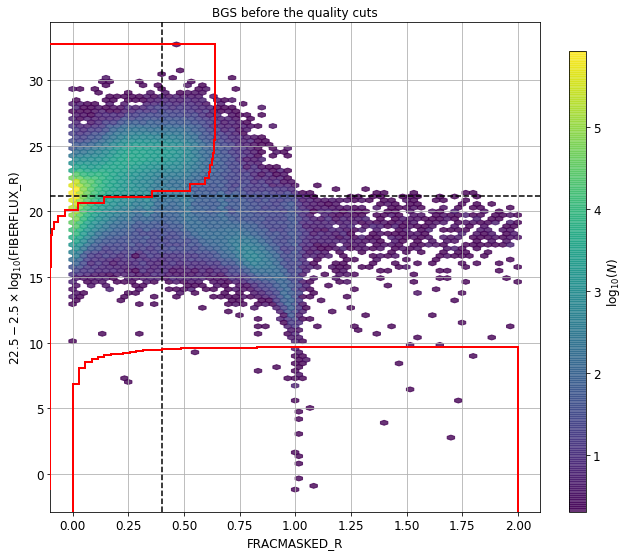

In [489]:
Mask1 = catr['FRACMASKED_R'] < 2
rmagr = flux_to_mag(catr['FLUX_R']/catr['MW_TRANSMISSION_R'])

fiberflux_lite(catr[Mask1], 'FRACMASKED_R', 'FIBERFLUX_R', 1400, 'BGS before the quality cuts', 0.4, 
               fixed=False)

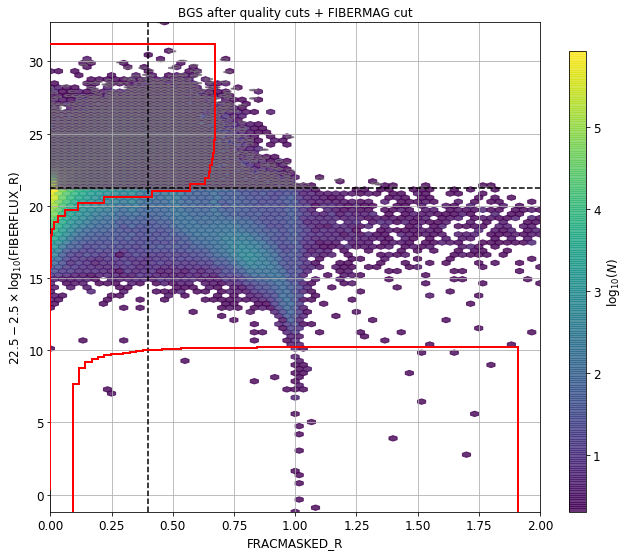

In [495]:

#mask_fiber = (mag2 > 21.2) & (rmagr > 19.5)
#cattmp = catr[Mask1]
#fibmagrT = flux_to_mag(cattmp['FIBERFLUX_R'])
#rmagrT = flux_to_mag(cattmp['FLUX_R']/cattmp['MW_TRANSMISSION_R'])
#mask_fiberT = (fibmagrT > 21.2) & (rmagrT > 19.5)
fiberflux_lite(catr[Mask1], 'FRACMASKED_R', 'FIBERFLUX_R', 1400, 'BGS after quality cuts + FIBERMAG cut', 0.4, 
               fixed=False, shadow=True)
#fiberflux_lite(catr[~mask_fiber], 'FRACMASKED_R', 'FIBERFLUX_R', 1400, 'BGS after quality cuts + FIBERMAG cut', 0.4, fixed=False)

In [498]:
print(len(catr[~qcsMask]), len(cat))

5562915 5562915


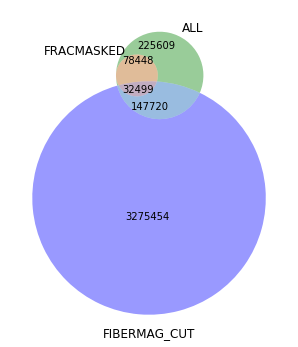

In [508]:
from matplotlib_venn import venn3, venn3_circles

del fibmag, rmag, mask_fiber

fibmag = flux_to_mag(catr['FIBERFLUX_R'])
rmag = flux_to_mag(catr['FLUX_R']/catr['MW_TRANSMISSION_R'])
mask_fiber = (fibmag > 21.2) & (rmag > 19.5)
plt.figure(figsize=(6, 6))

mask11 = ~catr['VETO_FRACMASKED']

venn3([set(catr['RA'][mask11]), set(catr['RA'][qcsMask]), set(catr['RA'][mask_fiber])],
      set_labels = ('FRACMASKED', r'ALL', 'FIBERMAG_CUT'))